In [4]:
from sklearn.datasets import load_boston
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ExpSineSquared, RationalQuadratic, WhiteKernel
from sklearn import preprocessing

from scipy import interpolate

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import scipy

import seaborn as sns

from calendar import month_name as mn
import datetime
from matplotlib.dates import MonthLocator, DateFormatter
import matplotlib.dates as mdates #for working with dates in plots

#FOR PLOTTING
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import tempfile
import plotly.figure_factory as ff

import wandb

wandb.li

In [8]:
wandb.init(
    project = "syn_model_sklearn",
    notes = "tracking sklearn",
    tags = ["sklearn","gpr","syn"])

file_path = "/D/MIT-WHOI/github_repos/syn_model/data/dfmerged_dailysynenv.csv"

wandb.log_artifact(file_path, name = "syn_data",type = "dataset")


AttributeError: module 'wandb' has no attribute 'init'

# Importing and describing the data

In [36]:
def import_data():
    PATH = "../data/dfmerged_dailysynenv.csv"
    df = pd.read_csv(PATH)#.drop_duplicates(subset = "date") #remove duplicate days

    months = mn[1:] #importing month names from calendar

    #reformat dates to datetime format
    df.date = pd.to_datetime(df.date, format = "%Y-%m-%d")
    df.year = df.date.dt.year
    df.month = df.date.dt.month
    df["doy_numeric"] = df.date.dt.dayofyear
    df["doy"] = pd.to_datetime(df.date.dt.dayofyear, format = "%j")
    df["monthname"] = pd.Categorical(df.date.dt.month_name(), categories=months, ordered = True)
    df["year_numeric"] = df.year + df.doy_numeric/365

    df["temp"] = df.Beam_temperature_corrected
    return df

def plot_temperature_doy():
    fig = plt.figure(figsize=(15, 8))

    #PLOTTING TEMPERATURE
    temp  = plt.scatter(df.doy_numeric,df.temp, s = 4 , label = "observations")

    #COLORED BY SYN CONC
    # temp  = plt.scatter(df.doy_numeric,df.temp, c = np.log(df.synconc), cmap = cm, s = 4 )
    # cbar = plt.colorbar(temp)
    # cbar.set_label("Syn Concentration", rotation=270)

    #CALCULATE MOVING AVERAGE
    window_size = 7
    # Convert array of integers to pandas series
    numbers_series = df.groupby("doy_numeric")["temp"].mean()
    # plt.plot(numbers_series)
    # Get the window of series
    # of observations of specified window size
    windows = numbers_series.rolling(window_size)
    # Create a series of moving
    # averages of each window
    moving_averages = windows.mean()
    moving_std = windows.std()


    #PLOTTING MOVING AVERAGE
    plt.plot(moving_averages,c = "k",lw = 2,label = str(window_size) + "-day moving average")
    #PLOTTING STANDARD DEVIATION
    plt.fill_between(
        np.linspace(1,366,366),
        moving_averages - moving_std,
        moving_averages + moving_std,
        color="tab:orange",
        alpha=0.3,
        label = "+- 1 std"
    )

    plt.title("SST over the Year",fontsize = 20)
    plt.ylabel("SST", fontsize = 20)
    plt.xlabel("Day of the Year",fontsize = 20)
    plt.legend()
    plt.grid() 
    
def plot_syn_temp():
    plt.figure(figsize=(15, 8))

    #PLOTTING SYN
    cm = plt.cm.get_cmap('hsv')
    syn = plt.scatter(df.doy_numeric,np.log(df.synconc), c = df.temp, cmap = cm, s = 4)
    # plt.plot(df.doy_numeric,np.log(df.synconc))
    cbar = plt.colorbar(syn,pad = 0.02)
    cbar.set_label("Syn Concentration")

    #CALCULATING MOVING AVERAGE
    window_size = 7
    # Convert array of integers to pandas series
    numbers_series = np.log(df.groupby("doy_numeric")["synconc"].mean())
    # plt.plot(numbers_series)
    # Get the window of series
    # of observations of specified window size
    windows = numbers_series.rolling(window_size)
    # Create a series of moving
    # averages of each window
    moving_averages = windows.mean()

    #PLOTTING MOVING AVERAGE
    plt.plot(moving_averages,c = "k",lw = 2,label = str(window_size) + "-day moving average")

    plt.title("Log-transformed Syn concentration colored by SST")
    plt.ylabel("log(Syn concentration)")
    plt.xlabel("Day of the Year")
    plt.legend()
    plt.ylim([0,13])

def plot_syn_distributions():
    fig,axs = plt.subplots(2,2,figsize=(24,12), dpi = 500)

    data_hist = (np.log(df.synconc)).dropna() #log transforming the data and dropping na values for the histogram

    #################################
    #PLOTTING ORIGINAL DISTRIBUTION
    #################################
    _, bins, _ = axs[0,0].hist(df.synconc[df.doy_numeric <= 365/2], 200, density=1, alpha=1)
    axs[0,0].set_title("Original Distribution")

    ###############################
    #GAMMA DISTRIBUTION
    ###############################
    axs[1,0].set_title("Log-Gamma Distribution Fit")
    _, bins, _ = axs[1,0].hist(data_hist, 200, density=1, alpha=1)

    fit_alpha, fit_loc, fit_beta = scipy.stats.gamma.fit(data_hist)
    bfl_gamma = scipy.stats.gamma.pdf(bins, fit_alpha,fit_loc,fit_beta)
    axs[1,0].plot(bins,bfl_gamma,label = "Log-Gamma")

    ###################################
    #LOG NORMAL DISTRIBUTION
    ##################################
    mean, var = scipy.stats.norm.fit(data_hist)
    best_fit_line = scipy.stats.norm.pdf(bins,mean,var)

    axs[1,0].plot(bins, best_fit_line, c = "r" ,label = "Log-Normal")

    #######################################
    #PLOTTING FREQUENCY
    #########################################
    #CALCULATING THE FFT
    fft = np.fft.rfft(df['synconc'].dropna())
    f_per_dataset = np.arange(0, len(fft))

    n_samples_d = len(df['synconc'].dropna())
    days_per_year = 365.2524
    years_per_dataset = n_samples_d/(days_per_year)

    print( "Number of Samples: " + str(n_samples_d))
#     print(years_per_dataset)

#     print(f_per_dataset)
    f_per_year = f_per_dataset/years_per_dataset
    
    #PLOTTING IN FREQUENCY SPACE
    axs[0,1].step(f_per_year, np.abs(fft),linewidth = 3)

    axs[0,1].set_xscale('log')
    axs[0,1].set_title("Syn Conc at MVCO", fontsize = 20)
    axs[0,1].set_xticks([1, 365.2524], labels=['1/Year', '1/day'],fontsize = 15)
    axs[0,1].set_xlabel('Frequency (log scale)', fontsize = 20)
    axs[0,1].set_ylabel("Number of Observations",fontsize = 20)
    
    #########################################################
    #PLOTTING WINTER AND SUMMER DISTRIBUTIONS
    #########################################################
    _, bins, _ = axs[1,1].hist(data_hist[df.temp <= 11], 200, density=1, alpha=1,label = "Winter")

    mean, var = scipy.stats.norm.fit(data_hist[df.temp <= 10])
    best_fit_line = scipy.stats.norm.pdf(bins,mean,var)

    axs[1,1].plot(bins, best_fit_line, c = "blue" ,label = "Log-Normal Fit")

    _, bins, _ = plt.hist(data_hist[df.temp >= 11], 200, density=1, alpha=1,color = "red",label = "Summer")

    mean, var = scipy.stats.norm.fit(data_hist[df.temp >= 11])
    best_fit_line = scipy.stats.norm.pdf(bins,mean,var)

    axs[1,1].plot(bins, best_fit_line, c = "r" ,label = "Log-Normal Fit")

    axs[1,1].set_xlabel("log([Syn])")
    axs[1,1].set_ylabel("Frequency")
    axs[1,1].legend()
    axs[1,1].set_title("Plotting Winter and Summer Syn Concentration")
    
    fig.suptitle("Distribution of Synechecoccus Concentration", fontsize = 20)

    
def create_daily_df(df):
    #SETTING DAILY FREQUENCY TO DATA
    dfd = df.drop_duplicates(subset = "date").copy()

    print(dfd.shape)

    # dfindexed = dfd.groupby(pd.PeriodIndex(data = dfd.date,freq = "D"))
    dfd = dfd.set_index("date",inplace = False)
    dfd.head()

    dfd =dfd.asfreq("D")
    dfd = dfd.reset_index()

    print("shape after setting daily frequency: " + str(dfd.shape))
    dfd["lindex"] = dfd.index

    dfd["doy_numeric"] = dfd.date.dt.dayofyear
    dfd["year"] = dfd.date.dt.year
    dfd["log_syn"] = np.log(dfd.synconc)

    dfd.head()
    return dfd

def plot_sst_window():
    plt.figure(figsize=(8, 5))


    plt.hist(df[ (df.doy_numeric >= 1) & (df.doy_numeric <= 20)].temp)
    plt.hist(df[ (df.doy_numeric >= 20) & (df.doy_numeric <= 40)].temp)
    plt.hist(df[ (df.doy_numeric >= 40) & (df.doy_numeric <= 60)].temp)
    plt.hist(df[ (df.doy_numeric >= 60) & (df.doy_numeric <= 80)].temp)
    plt.hist(df[ (df.doy_numeric >= 80) & (df.doy_numeric <= 100)].temp)
    plt.hist(df[ (df.doy_numeric >= 100) & (df.doy_numeric <= 120)].temp)


    plt.title("Distribution SST in a given 20-day window of the Day of the Year", fontsize = 20)
    plt.xlabel("SST")
    plt.ylabel("Frequency")

def interpolate(dataframe,column): 
    #INTERPOLATION
    print("number of NaNs in " + str(column) + ":" + str(dataframe[column].isna().sum()))
    dataframe[column+"_filled"] = dataframe[column].interpolate(method = "cubic",limit = 7,limit_area = "inside")
    dataframe[column+"_interpolated"] = dataframe.groupby("doy_numeric")[column+"_filled"].apply(lambda x: x.fillna(x.mean())) #calculating the mean
    print("number of NaNs in " + str(column)  + ":" + " after interpolation:" + str(dataframe[column+"_interpolated"].isna().sum()))

    #INTERPOLATING THE STANDARD DEVIATION
    dataframe[column+"_std"] = dataframe[column]
    dataframe[column+"_std"] = dataframe.groupby("doy_numeric")[column+"_std"].apply(lambda x: x.fillna(x.std())) #calculating the mean
    dataframe[column+"_std"].loc[np.where(dataframe[column].notnull())[0]] = 0.2
    dataframe["daily_index"] = dataframe.index
    return dataframe


def plot_interpolation(dataframe,column,name):
    #SETTING FIGURE SIZE
    plt.figure(figsize=(18, 10),dpi = 800)

    #PLOTTING
    ##OBSERVATIONS
    plt.scatter(dataframe.date, dataframe[column], label = "Observations",marker = "x",c ="r")

    ##INTERPOLATION
    plt.plot(dataframe.date,dataframe[column+"_interpolated"],c = "tab:blue", label = "Interpolation")
    plt.plot
    plt.fill_between(
        dataframe.date,
        dataframe[column+"_interpolated"] - 2*dataframe[column+"_std"],
        dataframe[column+"_interpolated"] + 2*dataframe[column+"_std"],
        color="tab:blue",
        alpha=0.6,
        label = "std of interpolation"
    )

    #LABELS
    plt.title("Interpolation of "+ name, fontsize = 20)
    plt.xlabel("Year",fontsize = 20)
    plt.ylabel(name, fontsize = 20)
    plt.xticks(fontsize = 20)
    plt.yticks(fontsize = 20)
    plt.legend()
    plt.grid()
    
    plt.figure(figsize=(18, 10),dpi = 800)
    
def low_pass_weights(window, cutoff):
    """Calculate weights for a low pass Lanczos filter.

    Args:

    window: int
        The length of the filter window.

    cutoff: float
        The cutoff frequency in inverse time steps.

    """
    order = ((window - 1) // 2 ) + 1
    nwts = 2 * order + 1
    w = np.zeros([nwts])
    n = nwts // 2
    w[n] = 2 * cutoff
    k = np.arange(1., n)
    sigma = np.sin(np.pi * k / n) * n / (np.pi * k)
    firstfactor = np.sin(2. * np.pi * cutoff * k) / (np.pi * k)
    w[n-1:0:-1] = firstfactor * sigma
    w[n+1:-1] = firstfactor * sigma
return w[1:-1]
    
    

    sns.violinplot(data = dfd,x = dataframe.month,y = dataframe[column+"_interpolated"])
    

IndentationError: unexpected indent (1098272999.py, line 284)

In [22]:
df = import_data()
plot_syn_distributions() #depends on import_data()

df.describe().transpose()

Number of Samples: 4694


,count,mean,std,min,25%,50%,75%,max
AvgSolar,3575.0,151.168763,95.092767,-2.800000,74.882639,135.881944,223.602778,851.388235
AvgWindDir,3575.0,196.848362,72.442314,13.912500,149.199306,208.754167,249.670139,340.055556
AvgWindSpeed,3575.0,5.047937,2.234000,0.729167,3.526389,4.668056,6.047222,25.530556
Beam_temperature_corrected,3575.0,10.836090,6.373021,-1.419508,4.727163,10.991591,16.680652,21.855795
NH4_mean,1011.0,1.242777,1.088931,0.000000,0.507853,0.949099,1.784963,8.084891
NO3_mean,1011.0,0.345125,0.677637,0.000000,0.000000,0.080211,0.353688,6.561361
PO4_mean,1011.0,0.201055,0.179226,0.000000,0.070666,0.158569,0.283627,1.632589
SiO2_mean,1011.0,3.651877,3.574976,0.000000,1.236628,2.684718,4.980182,44.106465
doy_numeric,5541.0,187.463815,100.134435,1.000000,109.000000,187.000000,272.000000,366.000000
month,5541.0,6.664140,3.274614,1.000000,4.000000,7.000000,9.000000,12.000000


In [13]:
df.head()

,date,AvgSolar,AvgWindDir,AvgWindSpeed,Beam_temperature_corrected,NH4_mean,NO3_mean,PO4_mean,SiO2_mean,doy,doy_numeric,month,monthname,synconc,year,year_numeric,temp
0,2003-05-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1900-05-10,130,5,May,354.187094,2003,2003.356164,NaN
1,2003-05-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1900-05-11,131,5,May,381.916883,2003,2003.358904,NaN
2,2003-05-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1900-05-12,132,5,May,507.483356,2003,2003.361644,NaN
3,2003-05-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1900-05-13,133,5,May,704.463939,2003,2003.364384,NaN
4,2003-05-14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1900-05-14,134,5,May,898.691727,2003,2003.367123,NaN


# Analyzing Syn Data

In [14]:
fig = make_subplots(rows=2, cols=2,
                   subplot_titles = ("Original Distribution","Frequency of Syn Data","Log Normal Distribution","Winter and Summer Distributions"))


#################################
#PLOTTING ORIGINAL DISTRIBUTION
#################################
fig.add_trace(
    go.Histogram(x = df["synconc"], showlegend = False),
    row=1, col=1)

fig.update_xaxes(title_text="Syn Concentration", 
                 row=1, col=1)

fig.update_yaxes(title_text="Frequency", 
                 row=1, col=1)

#######################################
#PLOTTING FREQUENCY
#########################################
#CALCULATING THE FFT
fft = np.fft.rfft(df['synconc'].dropna())
f_per_dataset = np.arange(0, len(fft))

n_samples_d = len(df['synconc'].dropna())
days_per_year = 365.2524
years_per_dataset = n_samples_d/(days_per_year)

print( "Number of Samples: " + str(n_samples_d))
#     print(years_per_dataset)

#     print(f_per_dataset)
f_per_year = f_per_dataset/years_per_dataset

#plotting frequency
fig.add_trace(go.Scatter(x = f_per_year, y = np.abs(fft), showlegend = False),
           row=1, col=2)

fig.update_xaxes(title_text="Frequency (log scale)", 
                 type="log",
                 row=1, col=2,
                 tickvals = [1, 365.2524], 
                 ticktext = ['1/Year', '1/day'])

#######################################
#PLOTTING Log Normal Distribution
#########################################
fig.add_trace(
    go.Histogram(x = np.log(df["synconc"]),showlegend = False),
    row=2, col=1)


#######################################
#PLOTTING Winter and Summer Distributions
#########################################
# distplot
hist_data = [np.log(df[df.temp<=11]["synconc"]).dropna(), np.log(df[df.temp>=11]["synconc"]).dropna()]
group_labels = ['Winter','Summer']
fig2 = ff.create_distplot(hist_data, group_labels)


#PLOTTING HISTOGRAMS
fig.add_trace(go.Histogram(fig2['data'][0],
                           marker_color='blue',
                          name = "Winter"), 
              row=2, col=2)

fig.add_trace(go.Histogram(fig2['data'][1],
                           marker_color='red',
                          name = "Summer"), 
              row=2, col=2)


#PLOTTING DISTRIBUTIONS
fig.add_trace(
    go.Scatter(fig2['data'][2],
                         line=dict(color='blue', width=0.5),
                          name = "Winter"), 
                row=2, col=2)

fig.add_trace(
    go.Scatter(fig2['data'][3],
                         line=dict(color='red', width=0.5),
                          name = "Summer"), 
                row=2, col=2)



fig.update_layout(height=600, width=800, 
                  title_text="Syn Concentration Histogram",
                 legend=dict(
                    yanchor="bottom",
                    y=0.01,
                    xanchor="right",
                    x=1.18
                ))
fig.show()

# wandb.log({"syn_stats":plt})

Number of Samples: 4694


# Analyzing Temperature

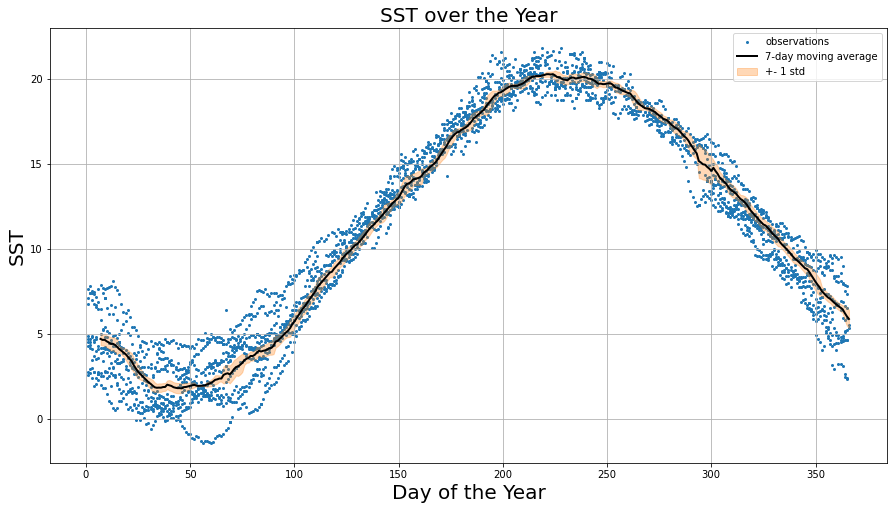

In [26]:
plot_temperature_doy()

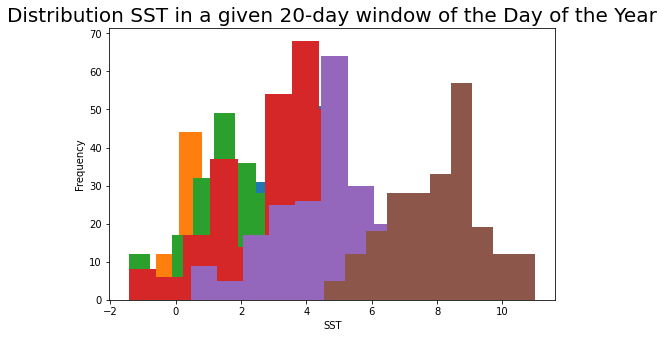

In [20]:
plot_sst_window()

# Creating dataset with daily frequency

In [23]:
dfd = create_daily_df(import_data())
dfd.head()

(4765, 17)
shape after setting daily frequency: (5598, 17)


,date,AvgSolar,AvgWindDir,AvgWindSpeed,Beam_temperature_corrected,NH4_mean,NO3_mean,PO4_mean,SiO2_mean,doy,doy_numeric,month,monthname,synconc,year,year_numeric,temp,lindex,log_syn
0,2003-05-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1900-05-10,130,5.0,May,354.187094,2003,2003.356164,NaN,0,5.869825
1,2003-05-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1900-05-11,131,5.0,May,381.916883,2003,2003.358904,NaN,1,5.945203
2,2003-05-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1900-05-12,132,5.0,May,507.483356,2003,2003.361644,NaN,2,6.229464
3,2003-05-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1900-05-13,133,5.0,May,704.463939,2003,2003.364384,NaN,3,6.557437
4,2003-05-14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1900-05-14,134,5.0,May,898.691727,2003,2003.367123,NaN,4,6.800940


# Interpolating Temperature

In [25]:
dfd = interpolate(dfd,"temp")
plot_interpolation(dfd,"temp","SST")

dfd = interpolate(dfd,"log_syn")
plot_interpolation(dfd,"log_syn","log(Syn Concentration)")

dfd.date.isna().sum()

number of NaNs in temp:2524
number of NaNs in temp: after interpolation:0
number of NaNs in log_syn:1591
number of NaNs in log_syn: after interpolation:0


0

# Seasonal Syn concentration colored by temperature

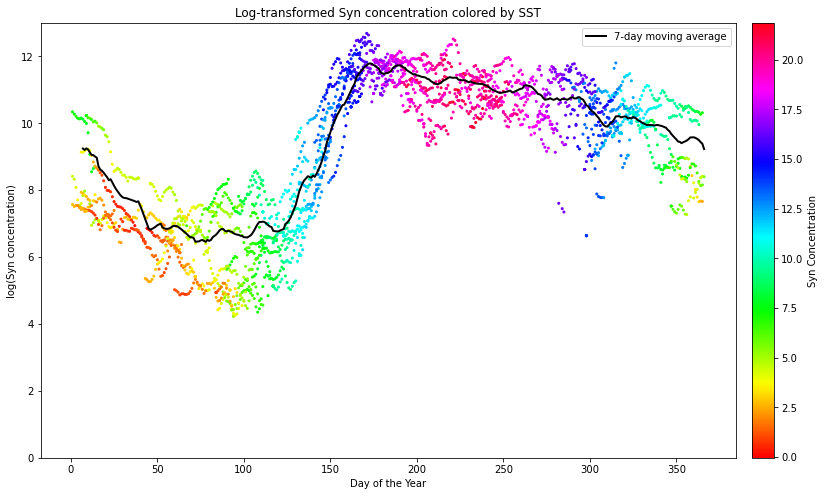

In [10]:

    
plot_syn_temp()

# Computing Timing of Spring Bloom

In [28]:
dfd.log_syn_interpolated.mean()

9.122053377435517

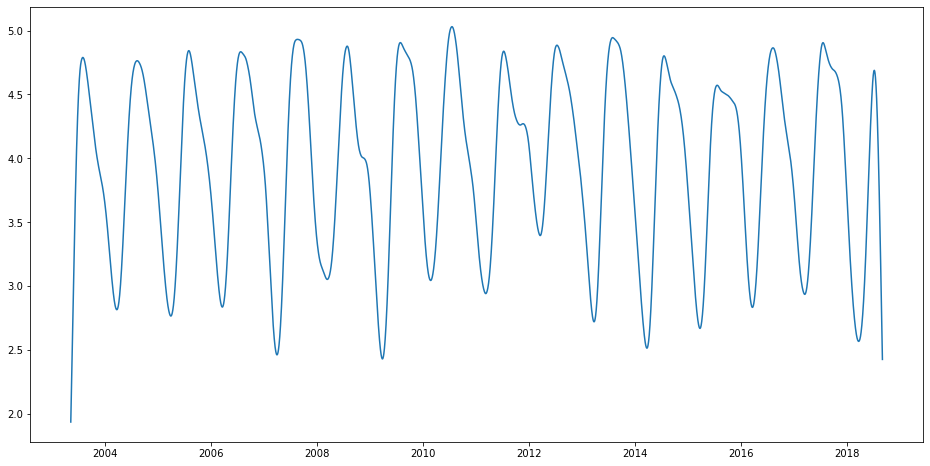

In [107]:
window = 28*5 #days
freq = 1/(28*13) #freqency to filer out

wgts = low_pass_weights(window, freq) 

dfd.log_syn_interpolated_lanc_filt= np.convolve(wgts, dfd['log_syn_interpolated'], mode='same')
dfd["log_syn_interpolated_grad"] = np.gradient(dfd.log_syn_interpolated_lanc_filt)


plt.figure(figsize = (16,8))
plt.plot(dfd.date,dfd.log_syn_interpolated_lanc_filt)


In [108]:
zero_crossing_index = np.where(np.diff(np.sign(dfd.log_syn_interpolated_grad)))[0] #extract index of all points that cross x-axis

second_deriv = np.gradient(dfd.log_syn_interpolated_grad)
pos_index = np.where(second_deriv > 0)
intersection_pos_index = np.intersect1d(zero_crossing_index,pos_index)


neg_index = np.where(second_deriv < 0)
intersection_neg_index = np.intersect1d(zero_crossing_index,neg_index)


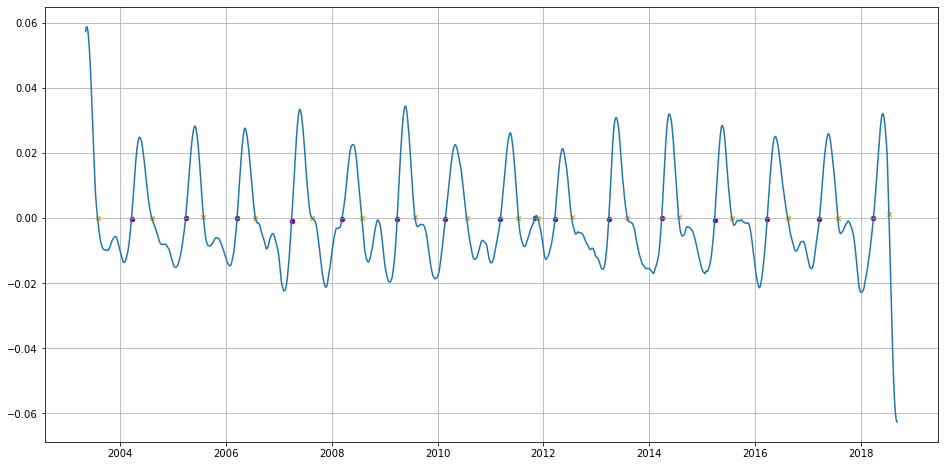

In [267]:
plt.figure(figsize = (16,8))
plt.plot(dfd.date, dfd.log_syn_interpolated_grad)
# plt.axhline(y=0, color='orange', linestyle='-')

plt.scatter(dfd.date[intersection_pos_index],dfd.log_syn_interpolated_grad[intersection_pos_index],
           color = "purple", marker = "o",s = 20)

plt.scatter(dfd.date[intersection_neg_index],dfd.log_syn_interpolated_grad[intersection_neg_index],
           color = "orange", marker = "x",s = 20)

plt.grid()


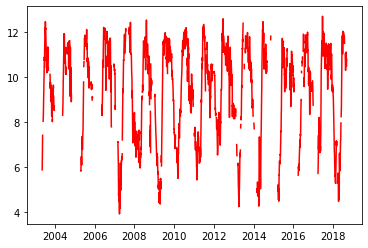

In [159]:
plt.plot(dfd.date,np.log(dfd.synconc),color = "red")

In [150]:
print(len(dfd.log_syn_interpolated_grad[intersection_pos_index]))

print(len(dfd.log_syn_interpolated_grad[intersection_neg_index][1:]))

bloom = pd.DataFrame([])

bloom["year"] = dfd.year[intersection_pos_index].reset_index(drop = True)
bloom["start_doy"] =  dfd.doy_numeric[intersection_pos_index].reset_index(drop = True)
bloom["end_doy"] = dfd.doy_numeric[intersection_neg_index][1:].reset_index(drop = True)
bloom["length"] =  bloom["end_doy"] - bloom["start_doy"]
bloom["data"] = "Observations"

bloom = bloom[bloom["length"] > 20]

16
16


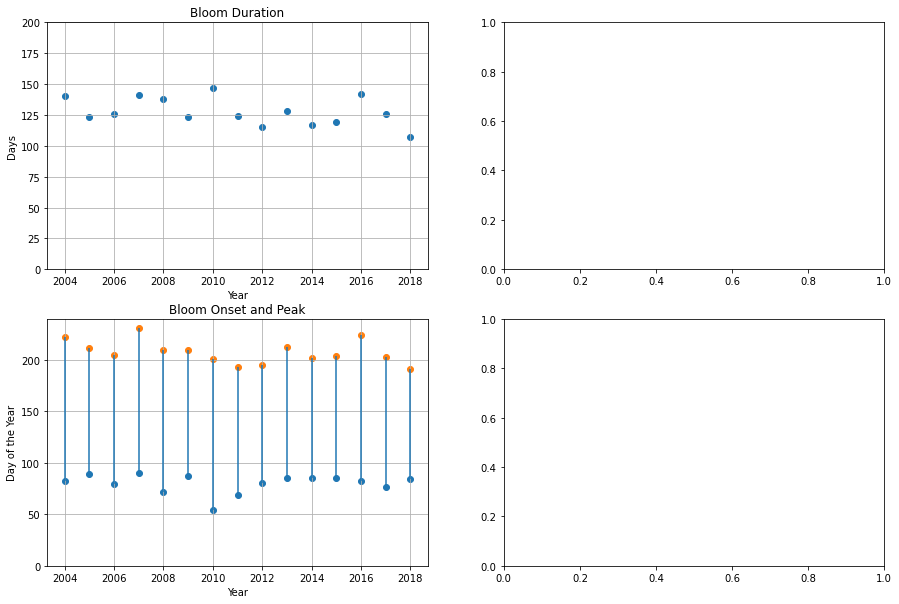

In [153]:
print(len(dfd.log_syn_interpolated_grad[intersection_pos_index]))

print(len(dfd.log_syn_interpolated_grad[intersection_neg_index][1:]))

bloom = pd.DataFrame([])

bloom["year"] = dfd.year[intersection_pos_index].reset_index(drop = True)
bloom["start_doy"] =  dfd.doy_numeric[intersection_pos_index].reset_index(drop = True)
bloom["end_doy"] = dfd.doy_numeric[intersection_neg_index][1:].reset_index(drop = True)
bloom["length"] =  bloom["end_doy"] - bloom["start_doy"]
bloom["data"] = "Observations"

bloom = bloom[bloom["length"] > 20]

#Plotting Blooom Dynamics

fig, axs = plt.subplots(2,2,figsize = (15,10))

axs[0,0].scatter(bloom["year"],bloom["length"],label="Observations")
axs[0,0].set_title("Bloom Duration")
axs[0,0].set_ylabel("Days")
axs[0,0].set_xlabel("Year")
axs[0,0].set_ylim([0,200])
axs[0,0].grid()


axs[1,0].scatter(bloom["year"],bloom["start_doy"], label = "Observations")
axs[1,0].scatter(bloom["year"],bloom["end_doy"], label = "Observations")
axs[1,0].vlines(bloom["year"],bloom["start_doy"],bloom["end_doy"])
axs[1,0].set_title("Bloom Onset and Peak")
axs[1,0].set_ylabel("Day of the Year")
axs[1,0].set_xlabel("Year")
axs[1,0].set_ylim([0,240])
axs[1,0].grid()





## Computing the spring threshold another way

In [45]:
dfd.describe()
dfd.columns

Index(['date', 'AvgSolar', 'AvgWindDir', 'AvgWindSpeed',
       'Beam_temperature_corrected', 'NH4_mean', 'NO3_mean', 'PO4_mean',
       'SiO2_mean', 'doy', 'doy_numeric', 'month', 'monthname', 'synconc',
       'year', 'year_numeric', 'temp', 'lindex', 'log_syn', 'temp_filled',
       'temp_interpolated', 'temp_std', 'daily_index', 'log_syn_filled',
       'log_syn_interpolated', 'log_syn_std'],
      dtype='object')

In [37]:
threshold_1 = 8*10**3 #cells /mL
threshold_2 = 1.6*10**4 #cells /mL
threshold_3 = 4.8*10**4 #cells /mL
threshold_4 = 9.6*10**5 #cells /mL

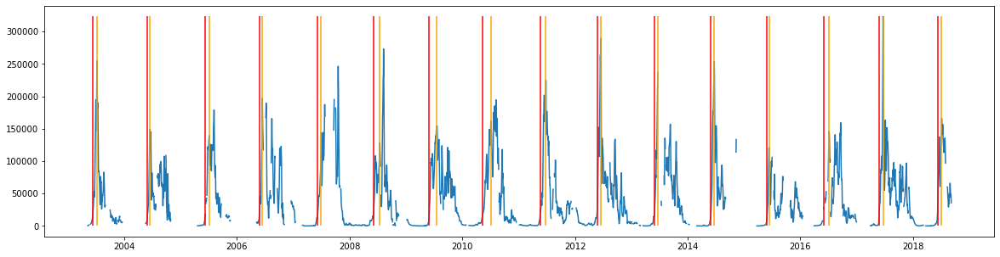

In [218]:
plt.figure(figsize = (20,5))
plt.plot(dfd.date,dfd.synconc)
plt.vlines(bloom_onset.date,ymin = 0, ymax = max(dfd.synconc) ,color = "r")
plt.vlines(bloom_peak.date,ymin = 0, ymax = max(dfd.synconc),color = "orange")

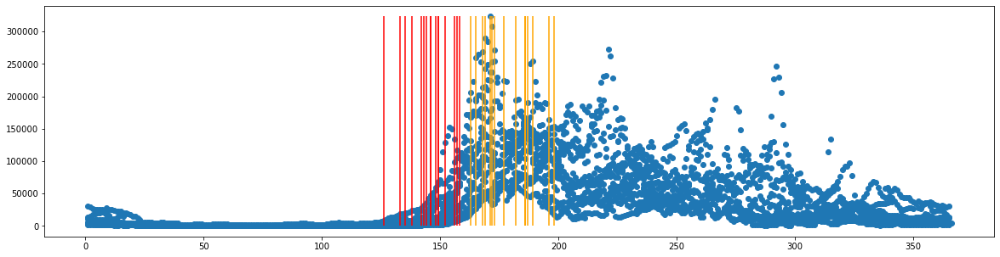

In [222]:
plt.figure(figsize = (20,5))
plt.scatter(dfd.doy_numeric,dfd.synconc)
plt.vlines(bloom_onset.doy_numeric,ymin = 0, ymax = max(dfd.synconc) ,color = "r")
plt.vlines(bloom_peak.doy_numeric,ymin = 0, ymax = max(dfd.synconc),color = "orange")

0     27
1     16
2     26
3     19
4     23
5     40
6     47
7     54
8     37
9     25
10    22
11    22
12    12
13    36
14    26
15    27
Name: doy_numeric, dtype: int64

/tmp/ipykernel_6036/544732073.py:5: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



<Figure size 432x288 with 0 Axes>

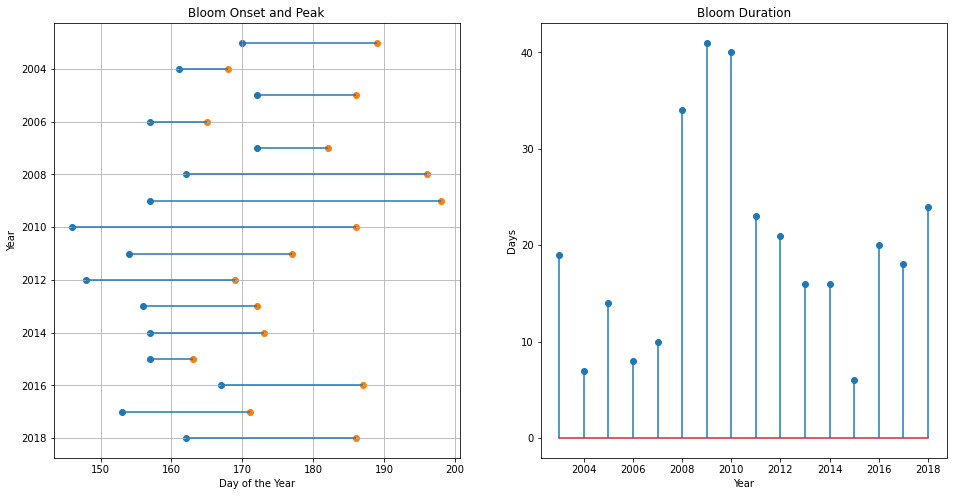

<Figure size 432x288 with 0 Axes>

In [287]:
threshold = threshold_3

within_bloom = np.where(np.logical_and(dfd.doy_numeric>=100, dfd.doy_numeric<=200))

bloom_onset = dfd.loc[within_bloom][dfd.synconc >= threshold].groupby("year").first().reset_index()
bloom_peak = dfd.loc[dfd.loc[within_bloom].groupby(['year'])['log_syn'].idxmax()]



fig, axs = plt.subplots(1,2,figsize = (16,8))
axs[0].scatter(bloom_onset.doy_numeric,bloom_onset.year)
axs[0].scatter(bloom_peak.doy_numeric,bloom_peak.year)
axs[0].hlines(bloom_peak.year,bloom_onset.doy_numeric,bloom_peak.doy_numeric)
axs[0].set_title("Bloom Onset and Peak")
# axs[0].set_ylim((0,240))
axs[0].grid()
axs[0].set_xlabel("Day of the Year")
axs[0].set_ylabel("Year")
axs[0].invert_yaxis()

axs[1].stem(bloom_onset.year,bloom_peak.doy_numeric.reset_index(drop = True) -bloom_onset.doy_numeric.reset_index(drop = True))
axs[1].set_title("Bloom Duration")
axs[1].set_ylabel("Days")
axs[1].set_xlabel("Year")

plt.figure()


## Preparing data for the GP process

## Using increasing vector for year

In [28]:
dfd.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
AvgSolar,3074.0,149.891778,94.450048,-2.800000,74.079861,132.141071,228.845833,851.388235
AvgWindDir,3074.0,198.149130,72.314866,13.912500,150.370833,210.491024,252.054167,340.055556
AvgWindSpeed,3074.0,5.216600,2.309749,0.729167,3.635764,4.793056,6.316319,25.530556
Beam_temperature_corrected,3074.0,10.641422,6.403568,-1.419508,4.714215,10.633121,16.645245,21.855795
NH4_mean,236.0,1.303932,1.124616,0.000000,0.595377,1.003303,1.847994,6.459085
NO3_mean,236.0,0.345473,0.730556,0.000000,0.000000,0.069010,0.286229,5.990000
PO4_mean,236.0,0.246616,0.235416,0.000000,0.083806,0.198548,0.333964,1.632589
SiO2_mean,236.0,4.612977,4.725445,0.000000,1.650261,3.462107,6.366639,44.106465
doy_numeric,5598.0,183.258307,104.449634,1.000000,94.000000,183.500000,272.000000,366.000000
month,4765.0,6.651836,3.330122,1.000000,4.000000,7.000000,10.000000,12.000000


In [198]:
dfd.log_syn_interpolated.mean()

9.122053377435517

In [191]:
#PREPARING DATA FOR GAUSSIAN PROCESS

def prepare_data_gp(dataframe, predictor,target):
#     dataframe[[predictors]] = dataframe.index

    # print(dfd[["daily_index","log_syn_interpolated","temp_interpolated"]].head())

    X = dataframe[[predictor]].to_numpy()
    y= dataframe[[target]].to_numpy()
    y_mean = y.mean()
    y = y - y_mean
    return X,y

X,y = prepare_data_gp(dfd[["daily_index","log_syn_interpolated"]].dropna(),"daily_index","log_syn_interpolated")
y_mean = y.mean()

print(y_mean)

print("It's important that X and y have the same shape.")
print(X.shape)
print(y.shape)

-5.584830363244803e-16
It's important that X and y have the same shape.
(5598, 1)
(5598, 1)


## function to plot gpr samples

In [155]:
def plot_gpr_samples(gpr_model, n_samples, ax):
    """Plot samples drawn from the Gaussian process model.

    If the Gaussian process model is not trained then the drawn samples are
    drawn from the prior distribution. Otherwise, the samples are drawn from
    the posterior distribution. Be aware that a sample here corresponds to a
    function.

    Parameters
    ----------
    gpr_model : `GaussianProcessRegressor`
        A :class:`~sklearn.gaussian_process.GaussianProcessRegressor` model.
    n_samples : int
        The number of samples to draw from the Gaussian process distribution.
    ax : matplotlib axis
        The matplotlib axis where to plot the samples.
    """
    x = np.linspace(0, 365*3, 500)
    X = x.reshape(-1, 1)

    y_mean, y_std = gpr_model.predict(X, return_std=True)
    y_samples = gpr_model.sample_y(X, n_samples)

    for idx, single_prior in enumerate(y_samples.T):
        ax.plot(
            x,
            single_prior,
            linestyle="--",
            alpha=0.7,
            label=f"Sampled function #{idx + 1}",
        linewidth = 5)
    ax.plot(x, y_mean, color="black", label="Mean")
    ax.fill_between(
        x,
        y_mean - y_std,
        y_mean + y_std,
        alpha=0.1,
        color="black",
        label=r"$\pm$ 1 std. dev.",
    )
    ax.set_xlabel("x",fontsize = 20)
    ax.set_ylabel("y",fontsize = 20)
#     ax.set_ylim([-3, 3])

# Kernel Design

We need to design a kernel that will be appropriate to use with our Guassian Process. We can make some assumptions about our data.

1. Long-Term Trend
2. Seasonal Variation
3. Smaller Irregularities
4. Noise

1. Long - Term Trend

There is a long-term trend in this analysis. We can use a Radial Basis Function as a prior to model a long term trned.

Radial Basis Function (RBF)

$\Large k(x_i, x_j) = e^{ \left ( \frac{d(x_i,x_j)^2}{2l^2} \right)}  $

$ \Large RBF(l=1) =   2^2\cdot RBF(l=1)$

where $l$ is the length scale

$d(x_i,x_j)$ is the Euclidean distance



In [156]:
ltt_sf = 1 #scaling factor
ltt_rbf_l = 365 #length scale of the radial basis function

ltt_rbf_lbound = 1e-2
ltt_rbf_ubound = 1e3

wandb.config.ltt_sf = ltt_sf
wandb.config.ltt_rbf = ltt_rbf_l

long_term_trend_kernel = ltt_sf* RBF(length_scale=ltt_rbf_l, length_scale_bounds=(ltt_rbf_lbound, ltt_rbf_ubound )) 

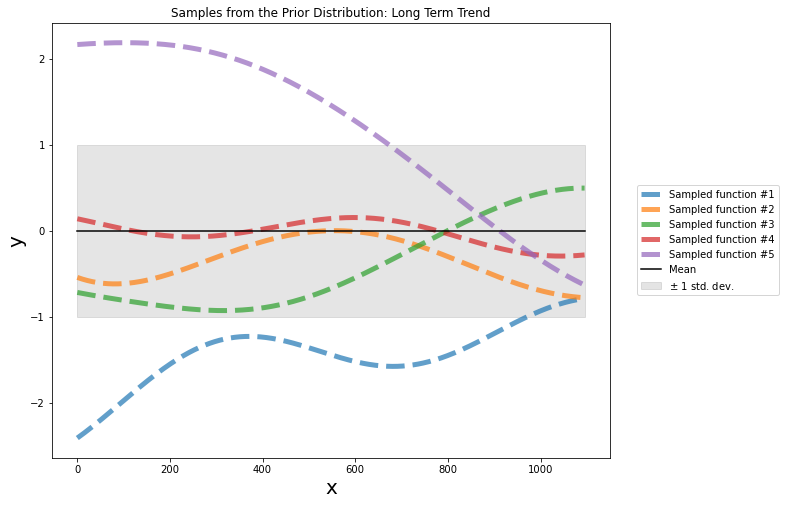

In [157]:
ltt_a = 0.5
wandb.config.ltt_a = ltt_a

longtermmodel = GaussianProcessRegressor(kernel = long_term_trend_kernel , alpha = ltt_a )
fig, axs = plt.subplots(nrows=1, sharex=True, sharey=True, figsize=(10, 8))

plot_gpr_samples(longtermmodel, n_samples=5,ax = axs)
axs.set_title("Samples from the Prior Distribution: Long Term Trend")
axs.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")
# axs.set_xlim(0,365)

## Plotting  Long Term Trend Correlation

Text(0.5, 1.0, 'Distance - Correlation Plot for Long Term Trend Kernel')

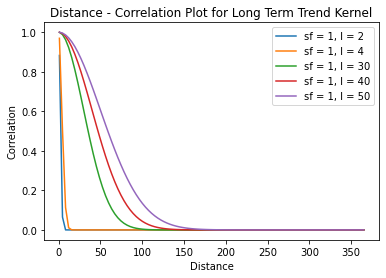

In [158]:
def rbf(x,l):
    # RADIAL BASIS FUNCTION
    return np.exp(-(x**2)/(2*(l**2)))

def lttk(x,l,sf): 
    # LONG TERM TREND KERNEL
    return sf*rbf(x,l)

x = np.linspace(1,365,100)
lttk_sf = 1

l = 2
plt.plot(x,lttk(x,l,sf = lttk_sf),label = 'sf = %.0f, l = %.0f' %(lttk_sf,l))
l = 4
plt.plot(x,lttk(x,l ,sf = lttk_sf),label = 'sf = %.0f, l = %.0f' %(lttk_sf,l))
l = 30
plt.plot(x,lttk(x,l ,sf = lttk_sf),label = 'sf = %.0f, l = %.0f' %(lttk_sf,l))
l = 40
plt.plot(x,lttk(x,l,sf = lttk_sf),label = 'sf = %.0f, l = %.0f' %(lttk_sf,l))
l = 50
plt.plot(x,lttk(x,l,sf = lttk_sf),label = 'sf = %.0f, l = %.0f' %(lttk_sf,l))
plt.legend()

plt.xlabel("Distance")
plt.ylabel("Correlation")
plt.title("Distance - Correlation Plot for Long Term Trend Kernel")

### 2. Seasonal Kernel

The prior autocorrelation analysis shows us that there is indeed seasonality in Syn. We can use the ExpSineSquared kernel function as a prior to model seasonality in our time series.

"The seasonal variation is explained by the periodic exponential sine squared kernel with a fixed periodicity of 1 year. The length-scale of this periodic component, controlling its smoothness, is a free parameter. In order to allow decaying away from exact periodicity, the product with an RBF kernel is taken. The length-scale of this RBF component controls the decay time and is a further free parameter. This type of kernel is also known as locally periodic kernel."

<!-- $\Large ExpSineSquared(l=1, p =1, pbounds = [0,2])$ -->
$\Large k(x_i,x_j)= e^{-\frac{2 sin ^2(\frac{\pi d(x_i, x_j)}{p})}{l^2}} $


Our final seasonal kernel looks like this:

$  \Large 2^2 \cdot RBF(l = 1) \cdot ExpSineSquared(l=1, p =1, pbounds = [0,2])$



In [159]:
sk_sf = 4
sk_rbf_l = 1

sk_ess_l = 1
sk_ess_p = 365

wandb.config.sk_sf = sk_sf
wandb.config.sk_rbf_l = sk_rbf_l
wandb.config.sk_ess_l = sk_ess_l
wandb.config.sk_ess_p = sk_ess_p

seasonal_kernel = (
    sk_sf
#     * RBF(length_scale=sk_rbf_l)
    * ExpSineSquared(length_scale=sk_ess_l, periodicity=sk_ess_p,
    periodicity_bounds=(sk_ess_p-20,sk_ess_p+20))
)

(-8.0, 8.0)

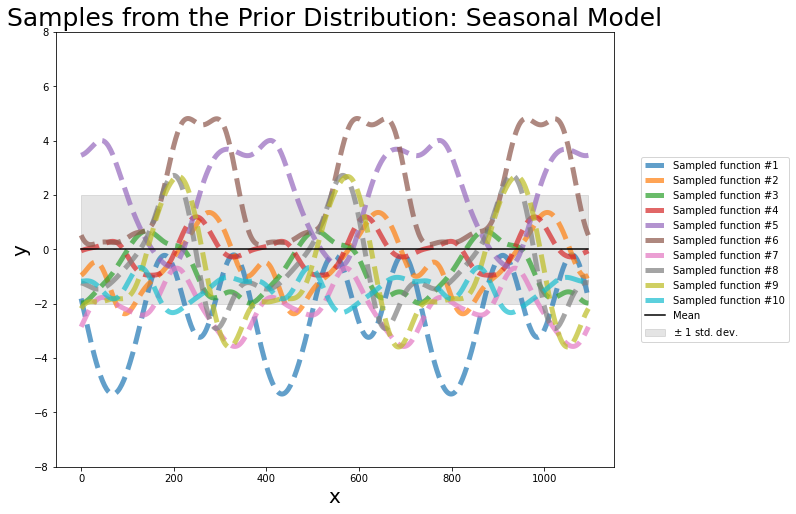

In [160]:
sk_a = 0.5

wandb.config.sk_a = 0.5

seasonalmodel = GaussianProcessRegressor(kernel = seasonal_kernel,alpha = sk_a)
fig, axs = plt.subplots(nrows=1, sharex=True, sharey=True, figsize=(10, 8))

plot_gpr_samples(seasonalmodel, n_samples=10,ax = axs)
axs.set_title("Samples from the Prior Distribution: Seasonal Model",fontsize = 25)
axs.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")
axs.set_ylim(-8,8)

## Plotting the Distance - Correlation relationship for the seasonal kernel

Text(0.5, 1.0, 'Distance - Correlation Relationship for Seasonal Kernel')

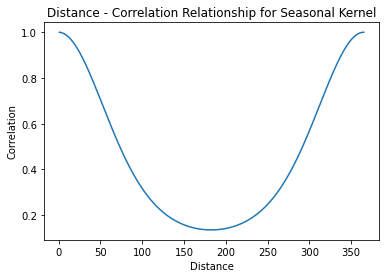

In [161]:
def ess(x,ess_l,p):
    return np.exp(-(2*np.sin(np.pi*x/p)**2)/ess_l**2)

def sk(x,rbf_l,ess_l,a,p):
    return ess(x,ess_l,p)
#     return a*rbf(x,rbf_l)*ess(x,ess_l,p)

x = np.linspace(1,365,1000)
# sk_a = 4**2
sk_a = 4
sk_rbf_l = 1 #radial basis fuction length scale
sk_ess_l = 1 #exponential sine squared function length scale (smoothness)
sk_ess_p = 365 # p parameter periodicity

plt.plot(x,sk(x,rbf_l = sk_rbf_l, ess_l = sk_ess_l , a = sk_a,p = sk_ess_p))
plt.xlabel("Distance")
plt.ylabel("Correlation")
plt.title("Distance - Correlation Relationship for Seasonal Kernel")

## Plotting effect of characteristic length scale and periodicity scale

Text(0.5, 1.0, 'Effect of changing periodicity')

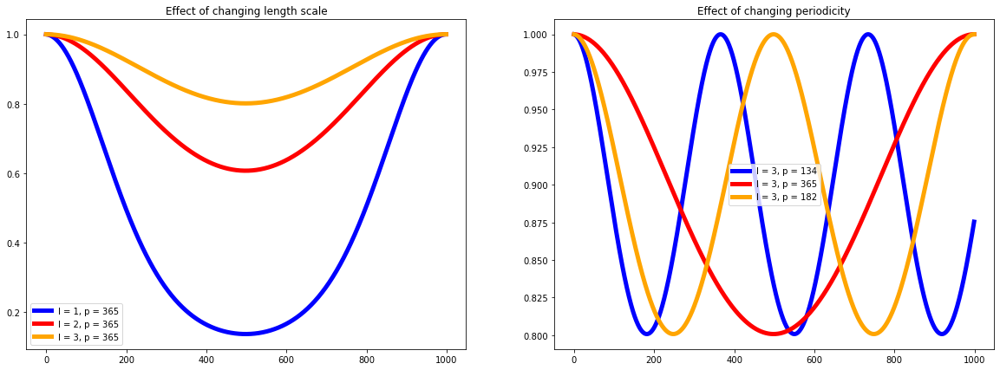

<Figure size 504x360 with 0 Axes>

In [162]:
x = np.linspace(1,365,1000)

fig, ax = plt.subplots(1,2,figsize = (20,7))
#PLOTTING LENGTH SCALE CHANGES
plt.figure(figsize=(7, 5))

ess_p = 365
ess_l = 1
ax[0].plot(ess(x,ess_l = ess_l,p = ess_p),c = "b",label = 'l = %.0f, p = %.0f' %(ess_l,ess_p),linewidth = 5)
ess_l = 2
ax[0].plot(ess(x,ess_l = ess_l,p = ess_p), c = "r",label = 'l = %.0f, p = %.0f' %(ess_l,ess_p),linewidth = 5)   
ess_l = 3
ax[0].plot(ess(x,ess_l = ess_l,p = ess_p), c = "orange",label = 'l = %.0f, p = %.0f' %(ess_l,ess_p),linewidth = 5)

ax[0].legend()
# plt.axvline(x = 365)
ax[0].set_title("Effect of changing length scale")


#PLOTTING PERIODICITY CHANGES
ess_p = 365/np.exp(1)
ax[1].plot(ess(x,ess_l = ess_l,p = ess_p),c = "b",label = 'l = %.0f, p = %.0f' %(ess_l,ess_p),linewidth = 5)
ess_p = 365
ax[1].plot(ess(x,ess_l = ess_l,p = ess_p), c = "r",label = 'l = %.0f, p = %.0f' %(ess_l,ess_p),linewidth = 5)
ess_p = 365/2
ax[1].plot(ess(x,ess_l = ess_l,p = ess_p), c = "orange",label = 'l = %.0f, p = %.0f' %(ess_l,ess_p),linewidth = 5)

# plt.axvline(x = 365)
ax[1].legend()
ax[1].set_title("Effect of changing periodicity")

# plt.plot(ess(x,ess_l = 20,p = 365), c = "b")

### 3. Smaller Irregularities

$\Large k(x_i,x_j) = \left( 1 + \frac{d(x_i,x_j)^2}{2 \alpha l^2}  \right )^{-\alpha}$

Where $\alpha$ = scale mixture parameter,
$l$ = length scale of the kernel


In [163]:
ik_sf = 3 #scaling factor for irregularities kernel
ik_rq_l = 2 #length scale of rational quadratic function of irregularities kernel
ik_rq_a = 1 #alpha parameter of rational quadratic function of irregularities kernel

wandb.config.ik_sf = ik_sf
wandb.config.ik_rq_l = ik_rq_l
wandb.config.ik_sf = ik_rq_a

irregularities_kernel = ik_sf * RationalQuadratic(length_scale=ik_rq_l, alpha=ik_rq_a)

(-8.0, 8.0)

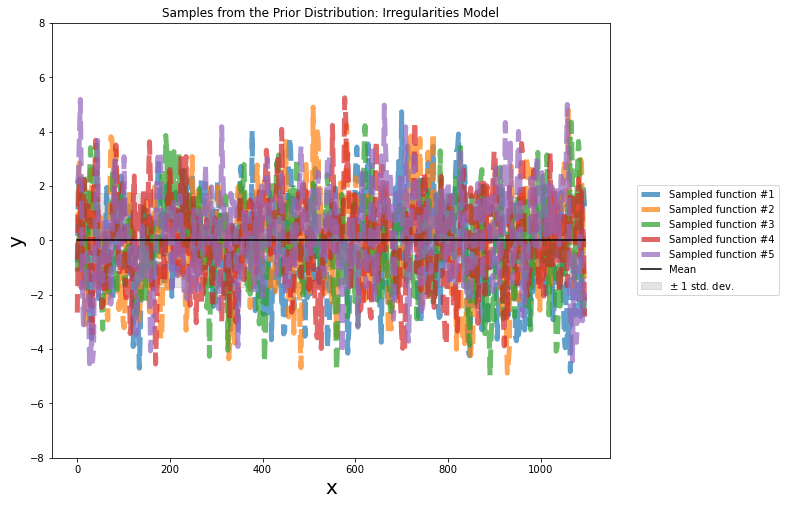

In [164]:
irregularitiesmodel = GaussianProcessRegressor(kernel = irregularities_kernel)
fig, axs = plt.subplots(nrows=1, sharex=True, sharey=True, figsize=(10, 8))

plot_gpr_samples(irregularitiesmodel, n_samples=5,ax = axs)
axs.set_title("Samples from the Prior Distribution: Irregularities Model")
axs.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")
axs.set_ylim(-8,8)

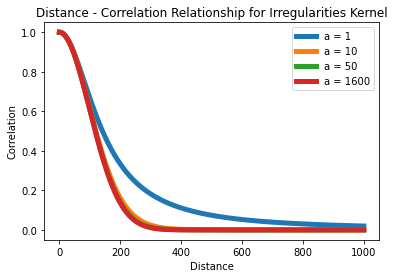

In [165]:
def rq(x,l,a):
    return (1 + (x**2)/(2*a*l**2))**(-a)

def ik(x,l,a,sf):
    return sf*rq(x,l,a)
    
x = np.linspace(0,10,1000)
ik_rq_l = 1 
ik_rq_a = 10
ik_sf = 1

#exploring the alpha parameter
a = 1
plt.plot(ik(x,l = ik_rq_l, a=a, sf = ik_sf), label = "a = %.0f" %a, linewidth = 5)
a = 10
plt.plot(ik(x,l = ik_rq_l, a=a, sf = ik_sf), label = "a = %.0f" %a, linewidth = 5)
a = 50
plt.plot(ik(x,l = ik_rq_l, a=a ,sf = ik_sf), label = "a = %.0f" %a, linewidth = 5)
a = 1600
plt.plot(ik(x,l = ik_rq_l, a=a, sf = ik_sf), label = "a = %.0f" %a, linewidth = 5)

plt.xlabel("Distance")
plt.ylabel("Correlation")
plt.title("Distance - Correlation Relationship for Irregularities Kernel")
plt.legend()

### 4. Noise

In [166]:
nk_sf = 0.05**2 #scaling factor of noise kernel
nk_rbf_l = 0.1 #length scale of radial basis function of noise kernel
nk_wnk_nl = 0.05**2 #noise level of white noise kernel of noise kernel

wandb.config.nk_sf = nk_sf
wandb.config.nk_rbf_l = nk_rbf_l
wandb.config.nk_wnk_nl = nk_wnk_nl


noise_kernel = nk_sf * RBF(length_scale=nk_rbf_l) + WhiteKernel(
    noise_level=nk_wnk_nl, noise_level_bounds=(1e-5, 1e5))

(-8.0, 8.0)

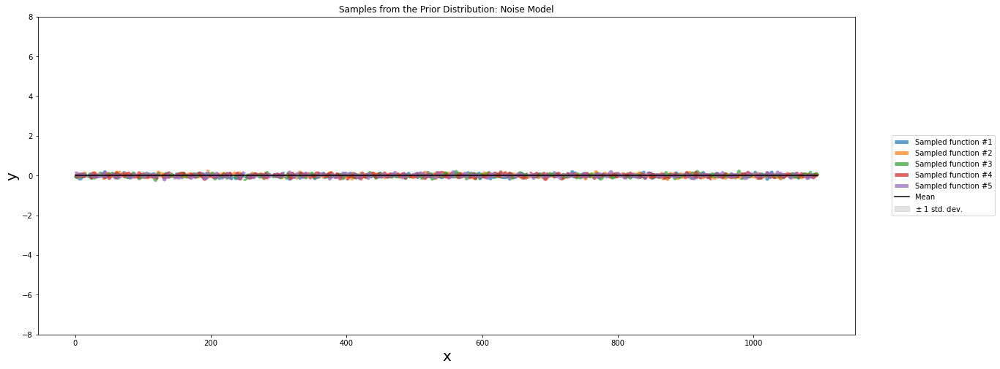

In [167]:
noisemodel = GaussianProcessRegressor(kernel = noise_kernel)
fig, axs = plt.subplots(nrows=1, sharex=True, sharey=True, figsize=(20, 8))

plot_gpr_samples(noisemodel, n_samples=5,ax = axs)
axs.set_title("Samples from the Prior Distribution: Noise Model")
axs.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")
axs.set_ylim(-8,8)

In [24]:
# def wnk(nl):
#     #defining White noise kernel
#     return 
    
# def nk(x,sf,l,nl):
#     #noise kernel
#     return sf*rbf(x,l)*wnk(nl)

# plt.plot(nk(x,nk_sf,nk_rbf_l,nl = nk_wnk_nl))

# Final Kernel

combinatio nof the previous kernels

In [168]:
final_kernel = (long_term_trend_kernel + seasonal_kernel + irregularities_kernel + noise_kernel)
# final_kernel = (long_term_trend_kernel + seasonal_kernel + noise_kernel)
final_kernel


1**2 * RBF(length_scale=365) + 2**2 * ExpSineSquared(length_scale=1, periodicity=365) + 1.73**2 * RationalQuadratic(alpha=1, length_scale=2) + 0.05**2 * RBF(length_scale=0.1) + WhiteKernel(noise_level=0.0025)

# Plotting the prior distributions

Let's visualize the prior distributions here.

I'd like to specify all values must be positive in this distribution over time.

kernel: covariance function

alpha: Value added to the diagonal of the kernel matrix during fitting. This can prevent a potential numerical issue during fitting, by ensuring that the calculated values form a positive definite matrix. It can also be interpreted as the variance of additional Gaussian measurement noise on the training observations. Note that this is different from using a WhiteKernel. If an array is passed, it must have the same number of entries as the data used for fitting and is used as datapoint-dependent noise level. Allowing to specify the noise level directly as a parameter is mainly for convenience and for consistency with Ridge.

(0.0, 1.5)

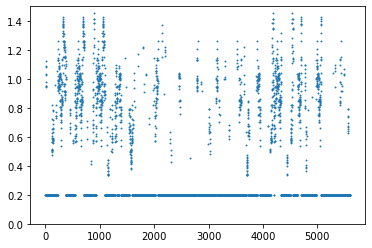

In [169]:
plt.scatter(dfd.daily_index,dfd.log_syn_std,s = 0.8)
plt.ylim([0,1.5])

In [55]:
dfd.log_syn_std**2

0       0.04
1       0.04
2       0.04
3       0.04
4       0.04
        ... 
5593    0.04
5594    0.04
5595    0.04
5596    0.04
5597    0.04
Name: log_syn_std, Length: 5598, dtype: float64

In [170]:
idxfull = np.where(dfd['log_syn'].isnull() == False)[0]

len(dfd.loc[idxfull].log_syn)

4007

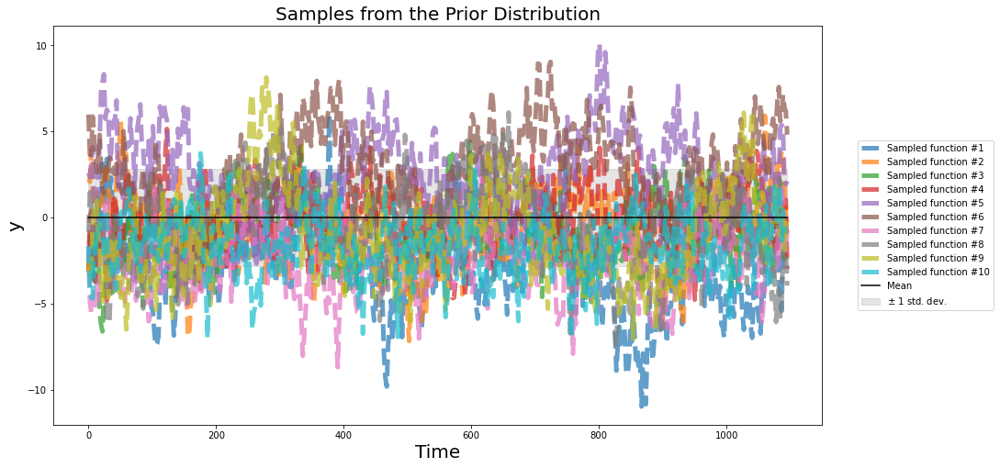

In [171]:

#SETTING UP GPR REGRESSOR
gpr_time = GaussianProcessRegressor(
    kernel = final_kernel , #kernel = covariance function of the GP
#     alpha =dfd.loc[idxfull].log_syn_std[1:ee]**2, #variance of additional Gaussian measurement noise on the training obervations
    alpha =0.75**2, #variance of additional Gaussian measurement noise on the training obervations
    normalize_y = True, #subtracts the mean
    n_restarts_optimizer=20 #number of restarts of optmizer for finding kernel's parameters that maxmize log-marginal likelohood)
)

#PLOTTING PRIOR DISTRIBUTIONS
def plotpriordistribution():
    fig, axs = plt.subplots(nrows=1, sharex=True, sharey=True, figsize=(15, 8)) #setting up figure

    plot_gpr_samples(gpr_time, n_samples=10,ax = axs)

    #LABELS
    axs.set_title("Samples from the Prior Distribution", fontsize = 20)
    axs.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")
    axs.set_xlabel("Time")
plotpriordistribution()

# Gaussian Process Fitting

In [197]:
training_size = 0.1

test_size = 1-training_size

wandb.config.test_size = test_size
wandb.config.training_size = training_size


X_train, X_test, y_train, y_test = train_test_split(X,y,test_size = test_size)

print(X_train.shape)
print(y_train.shape)

(559, 1)
(559, 1)


In [179]:
import time

#FITTING THE GAUSSIAN PROCESS
start = time.time()

gpr_time.fit(X_train,y_train)
end = time.time()

elapsed_time = (end - start)/60

#logging elapsed time
wandb.log({"elapsed time": elapsed_time})
print("elapsed time: " + str(elapsed_time) + " minutes")

#generating PREDICTION from GPR
today = datetime.datetime.now()
current_day = today.year + today.day / 365

mean_y_pred, std_y_pred = gpr_time.predict(X, return_std=True)
mean_y_pred += y_mean

mean_y_pred = mean_y_pred.reshape(-1,1)
std_y_pred = std_y_pred.reshape(-1,1)

elapsed time: 2.6864336093266803 minutes


# Plotting samples from the posterior distribution

In [182]:
#checking to see if mean prediction has any nan values
ee = 559
horizon = 500
jj = ee + horizon
(mean_y_pred - 3*std_y_pred).flatten()[1:jj]

array([-2.74928444, -2.6592429 , -2.5673469 , ..., -4.11636454,
       -4.11964312, -4.12133818])

In [183]:
horizon = 500
jj = ee + horizon


def plot_gp(dataframe, horizon, ee, jj):
    plt.figure(figsize=(25, 8), dpi = 1000)

#PLOTTING STANDARD DEVIATION CONTOUR
    plt.fill_between(
        dataframe.date[1:jj],
        (mean_y_pred - 3*std_y_pred).flatten()[1:jj],
        (mean_y_pred + 3*std_y_pred).flatten()[1:jj],
        color="tab:blue",
        alpha=0.043,
        label = "+- 3 std"
    )

    plt.fill_between(
        dataframe.date[1:jj],
        (mean_y_pred - 2*std_y_pred).flatten()[1:jj],
        (mean_y_pred + 2*std_y_pred).flatten()[1:jj],
        color="tab:blue",
        alpha=0.27,
        label = "+- 2 std"
    )

    plt.fill_between(
        dataframe.date[1:jj],
        (mean_y_pred - std_y_pred).flatten()[1:jj],
        (mean_y_pred + std_y_pred).flatten()[1:jj],
        color="tab:blue",
        alpha=0.68,
        label = "+- 1 std"
    )

    #PLOTTING GAUSSIAN PROCESS
    plt.plot(dataframe.date[1:jj], mean_y_pred[1:jj], color="blue", alpha=1, label="Gaussian process",linewidth = 3)


    # SAMPLING FROM THE POSTERIOR DISTRIBUTION
    # plot_gpr_samples(gpr_time, n_samples=5,ax = axs)
    # y_samples = gpr_time.sample_y(X[1:jj],10)

    # for idx, single_prior in enumerate(y_samples.T):
    #     plt.plot(
    #         dfd.date[1:jj-1],
    #         (single_prior.flatten()+y_mean)[1:jj],
    #         linestyle="--",
    #         alpha=0.7,
    #         label=f"Sampled function #{idx + 1}",
    #     linewidth = 3)

    # plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")

    #PLOTTING OBSERVATIONS
    plt.errorbar(dataframe.date[1:ee], np.squeeze(y[1:ee]+ y_mean), dfd.log_syn_std[1:ee],
                 linestyle = "None",
                 marker = ".",
                 color = "black",label = "Observations",
                markersize = 2)


    plt.legend(fontsize = 20)
    plt.xlabel("Year",fontsize = 20)
    plt.ylabel("Log(Daily Average of Syn Concentration)",fontsize = 20)
    # _ = plt.title("Daily Average of Syn Concentration", fontsize = 20)
    plt.grid()
    plt.savefig("/D/MIT-WHOI/github_repos/syn_model/results/" + str(ee) + "_" + str(jj) + "daily_average_log_syn.png")

horizon = 500   
plot_gp(dfd.loc[idxfull],horizon,ee, jj)

In [ ]:
dfd.resample('W', on='date')['count1','count2'].sum()

NameError: name 'gaussian_process' is not defined

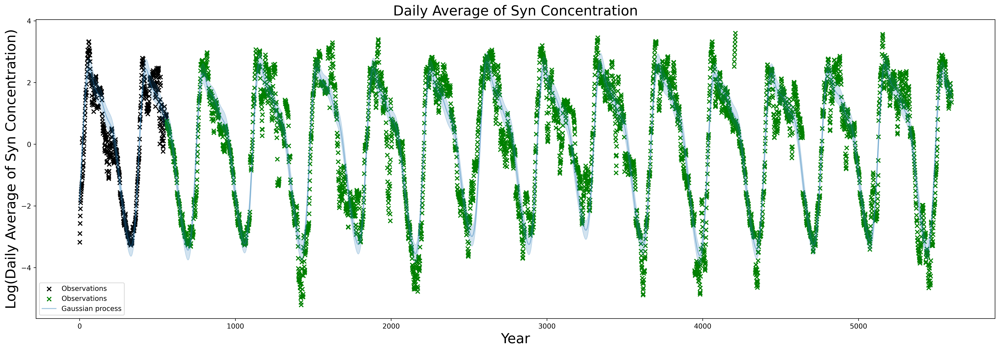

In [185]:
plt.figure(figsize=(25, 8),dpi = 500)

#PLOTTING OBSERVATIONS
plt.scatter(
    X[1:ee],
    y[1:ee]+ y_mean,
    color="black",
    marker = "x",
    label="Observations")

#PLOTTING UNSEEN OBSERVATIONS
plt.scatter(
    X[ee:len(X)],
    y[ee:len(y)]+ y_mean,
    color="green",
    marker = "x",
    label="Observations"
)

#PLOTTING GAUSSIAN PROCESS
plt.plot(
    X,
    mean_y_pred,
    color="tab:blue",
    alpha=0.4,
    label="Gaussian process"
)

#PLOTTING STD of GP
plt.fill_between(
    X.flatten(),
    (mean_y_pred - std_y_pred).flatten(),
    (mean_y_pred + std_y_pred).flatten(),
    color="tab:blue",
    alpha=0.2,
)

#LABELS
# plt.ylim([0,13])
plt.xlabel("Year",fontsize = 20)
plt.ylabel( "Log(Daily Average of Syn Concentration)" , fontsize = 20)
_ = plt.title( "Daily Average of Syn Concentration" , fontsize = 20)
plt.legend()

# plot_gpr_samples(gaussian_process, n_samples=5,ax = axs)
y_samples = gaussian_process.sample_y(X_test,5)

for idx, single_prior in enumerate(y_samples.T):
    plt.plot(
        X_test.flatten(),
        single_prior.flatten()+y_mean,
        linestyle="--",
        alpha=0.7,
        label=f"Sampled function #{idx + 1}",
    )

plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")



In [226]:
dfd["log_syn_pred"] = mean_y_pred+dfd.log_syn_interpolated.mean()
dfd["log_syn_pred_grad"] = np.gradient(dfd.log_syn_pred)

dfd["log_syn_pred"]
np.sign(dfd.log_syn_pred)

0       1.0
1       1.0
2       1.0
3       1.0
4       1.0
       ... 
5593    1.0
5594    1.0
5595    1.0
5596    1.0
5597    1.0
Name: log_syn_pred, Length: 5598, dtype: float64

In [227]:
zero_crossing_index = np.where(np.diff(np.sign(dfd.log_syn_pred_grad)))[0] #extract index of all points that cross x-axis

second_deriv = np.gradient(dfd.log_syn_pred)
pos_index = np.where(second_deriv > 0)
intersection_pos_index_pred = np.intersect1d(zero_crossing_index,pos_index)


neg_index = np.where(second_deriv < 0)
intersection_neg_index_pred = np.intersect1d(zero_crossing_index,neg_index)



[  60  425  791 1155 1523 1885 2252 2614 2980 3344 3711 4077 4441 4806
 5171 5536]
[  60  329  425  696  791 1059 1155 1425 1523 1789 1885 2155 2252 2518
 2614 2884 2980 3250 3344 3615 3711 3981 4077 4345 4441 4711 4806 5074
 5171 5441 5536]


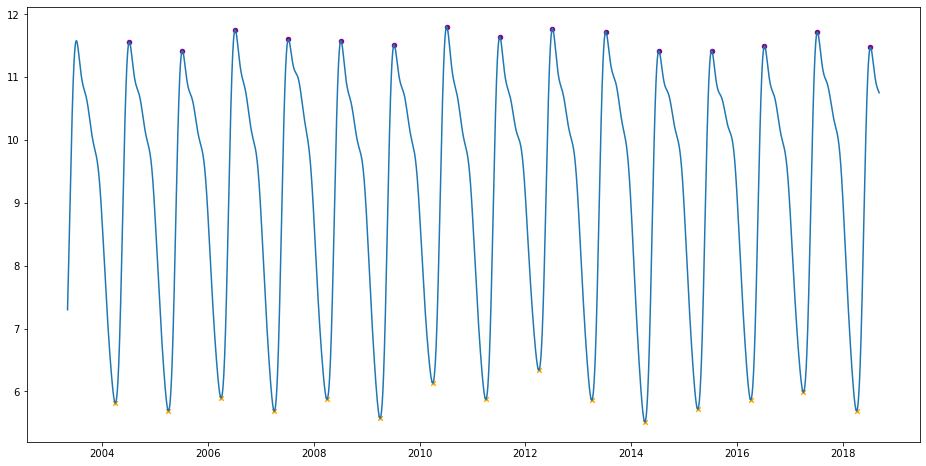

In [242]:
plt.figure(figsize = (16,8))
plt.plot(dfd.date, dfd.log_syn_pred)
# plt.axhline(y=0, color='orange', linestyle='-')

plt.scatter(dfd.date[intersection_pos_index_pred][1:],dfd.log_syn_pred[intersection_pos_index_pred][1:],
           color = "purple", marker = "o",s = 20)

plt.scatter(dfd.date[intersection_neg_index_pred],dfd.log_syn_pred[intersection_neg_index_pred],
           color = "orange", marker = "x",s = 20)




In [238]:
bloom_pred.describe()

,year,start_doy,end_doy,length
count,16.000000,16.000000,14.000000,14.000000
mean,2010.500000,188.687500,92.571429,-96.357143
std,4.760952,1.447699,1.222500,1.499084
min,2003.000000,187.000000,90.000000,-99.000000
25%,2006.750000,187.750000,92.000000,-97.750000
50%,2010.500000,188.500000,93.000000,-96.000000
75%,2014.250000,190.000000,93.000000,-96.000000
max,2018.000000,192.000000,95.000000,-94.000000


16
16


(0.0, 240.0)

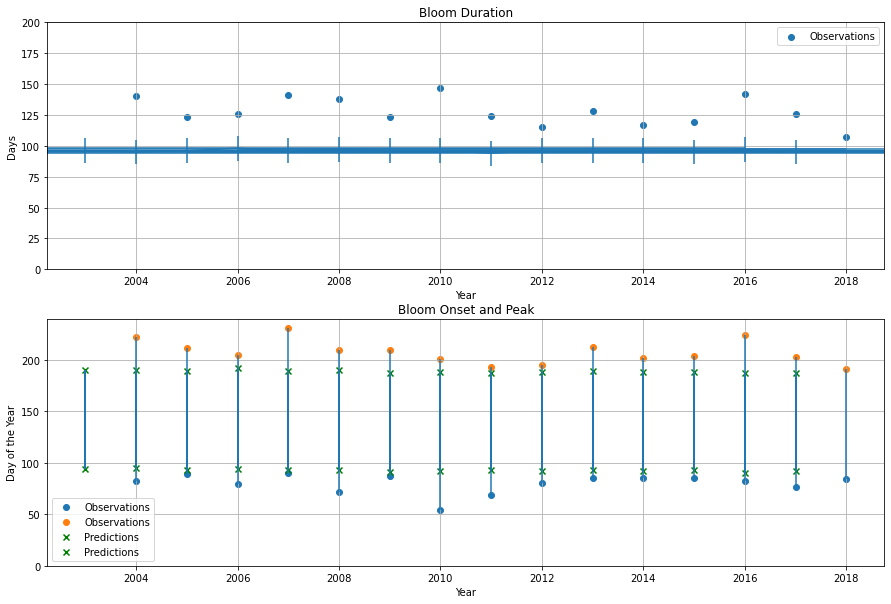

In [262]:
print(len(dfd.log_syn_pred_grad[intersection_pos_index]))

print(len(dfd.log_syn_pred_grad[intersection_neg_index][1:]))

bloom = pd.DataFrame([])

bloom["year"] = dfd.year[intersection_pos_index].reset_index(drop = True)
bloom["start_doy"] =  dfd.doy_numeric[intersection_pos_index].reset_index(drop = True)
bloom["end_doy"] = dfd.doy_numeric[intersection_neg_index][1:].reset_index(drop = True)
bloom["length"] =  bloom["end_doy"] - bloom["start_doy"]
bloom["data"] = "Observations"

bloom = bloom[bloom["length"] > 20]


bloom_pred = pd.DataFrame([])

bloom_pred["year"] = dfd.year[intersection_pos_index_pred].reset_index(drop = True)
bloom_pred["start_doy"] =  dfd.doy_numeric[intersection_pos_index_pred][1:].reset_index(drop = True)
bloom_pred["end_doy"] = dfd.doy_numeric[intersection_neg_index_pred].reset_index(drop = True)
bloom_pred["length"] =  bloom_pred["end_doy"] - bloom_pred["start_doy"]
bloom_pred["data"] = "Predictions"

#Plotting Blooom Dynamics

fig, axs = plt.subplots(2,1,figsize = (15,10))

axs[0].scatter(bloom["year"],bloom["length"],label="Observations")
axs[0].set_title("Bloom Duration")
axs[0].set_ylabel("Days")
axs[0].set_xlabel("Year")
axs[0].set_ylim([0,200])


axs[1].scatter(bloom["year"],bloom["start_doy"], label = "Observations")
axs[1].scatter(bloom["year"],bloom["end_doy"], label = "Observations")
axs[1].vlines(bloom["year"],bloom["start_doy"],bloom["end_doy"])
axs[1].set_title("Bloom Onset and Peak")
axs[1].set_ylabel("Day of the Year")
axs[1].set_xlabel("Year")
axs[1].set_ylim([0,240])
axs[1].grid()


# axs[0].scatter(bloom_pred["year"],abs(bloom_pred["length"]),label="Predictions",c = "green", marker = "x")
axs[0].errorbar(bloom_pred["year"],abs(bloom_pred["length"]),yerr = 10,xerr = 10,)
axs[0].legend()
axs[0].set_title("Bloom Duration")
axs[0].set_ylabel("Days")
axs[0].set_xlabel("Year")
axs[0].set_ylim([0,200])
axs[0].grid()

axs[1].scatter(bloom_pred["year"],bloom_pred["start_doy"], label = "Predictions",c = "green", marker = "x")
axs[1].scatter(bloom_pred["year"],bloom_pred["end_doy"], label = "Predictions",c = "green", marker = "x")
axs[1].vlines(bloom_pred["year"],bloom_pred["start_doy"],bloom_pred["end_doy"],lw = 2)
axs[1].legend()
axs[1].set_title("Bloom Onset and Peak")
axs[1].set_ylabel("Day of the Year")
axs[1].set_xlabel("Year")
axs[1].set_ylim([0,240])




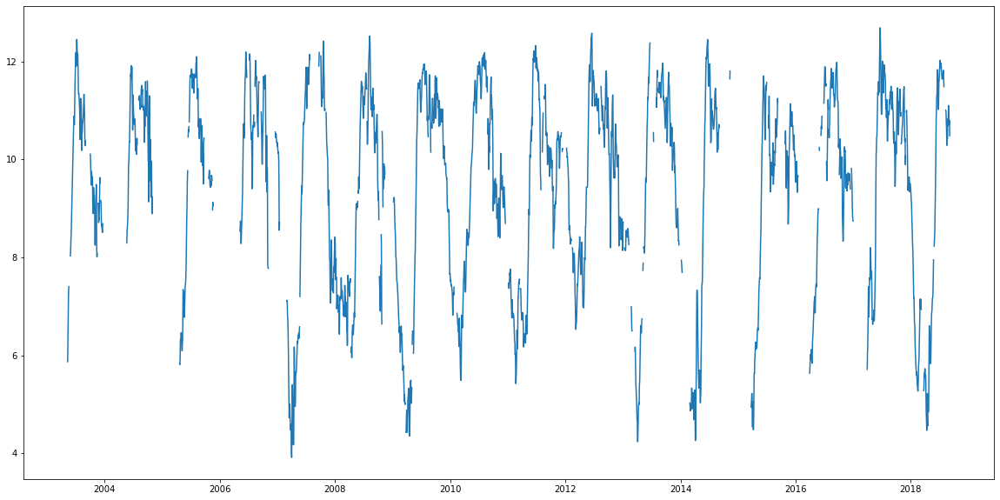

In [266]:
plt.figure(figsize = (20,10))
plt.plot(dfd.date,dfd.log_syn)


## Plotting GPR Score

$R^2$ is the coefficient of determination.

\begin{align*}R^2 = \left( 1-\frac{u}{v} \right) \end{align*}

 where u is the residual sum of squares, $ u = \sum_{i = 1}^{N} (y_{true,i} - y_{pred,i})^2 $, and v is the total sum of squares, $v= \sum_{i = 1}^{N} (y_{true,i} - \bar y_{true,i})^2$.

In [87]:
gpr_time.get_params()
gpr_time.score(X,y)                                                


0.8003022651072479

## Calibration Score

Frequency of real data lying within the obtained confidence region

\begin{align*} \text{CS} = \frac{1}{N}\sum \limits _{j = 1}^N {{{\left[ {\left| {{y_j} - {{\tilde{y}}_j}} \right| < 2\sigma } \right]}_I}}\end{align*}

where $y_j$ is an observation at index j, $\tilde y_j$ is the prediction of the gaussian process at index j, and  $[\cdot]_{I}$ is the Iverson Bracket

In [88]:
#calculating calibration score

def cs(y,mean_y_pred,std_y_pred):
    vals = abs(y - mean_y_pred)
    return (vals[vals < 2*std_y_pred].sum())/len(y)

print("Calibration Score: " + str(cs(y+y_mean,mean_y_pred,std_y_pred)))

Calibration Score: 0.49370115565003503


In [89]:
gpr_time.get_params()

{'alpha': 0.5625,
 'copy_X_train': True,
 'kernel__k1': 1**2 * RBF(length_scale=365) + 2**2 * ExpSineSquared(length_scale=1, periodicity=365) + 1.73**2 * RationalQuadratic(alpha=1, length_scale=2),
 'kernel__k2': 0.05**2 * RBF(length_scale=0.1) + WhiteKernel(noise_level=0.0025),
 'kernel__k1__k1': 1**2 * RBF(length_scale=365) + 2**2 * ExpSineSquared(length_scale=1, periodicity=365),
 'kernel__k1__k2': 1.73**2 * RationalQuadratic(alpha=1, length_scale=2),
 'kernel__k1__k1__k1': 1**2 * RBF(length_scale=365),
 'kernel__k1__k1__k2': 2**2 * ExpSineSquared(length_scale=1, periodicity=365),
 'kernel__k1__k1__k1__k1': 1**2,
 'kernel__k1__k1__k1__k2': RBF(length_scale=365),
 'kernel__k1__k1__k1__k1__constant_value': 1,
 'kernel__k1__k1__k1__k1__constant_value_bounds': (1e-05, 100000.0),
 'kernel__k1__k1__k1__k2__length_scale': 365,
 'kernel__k1__k1__k1__k2__length_scale_bounds': (0.01, 1000.0),
 'kernel__k1__k1__k2__k1': 2**2,
 'kernel__k1__k1__k2__k2': ExpSineSquared(length_scale=1, periodicit

In [91]:
def plot_gpr_samples_2D(gpr_model, n_samples, ax):
    """Plot samples drawn from the Gaussian process model.

    If the Gaussian process model is not trained then the drawn samples are
    drawn from the prior distribution. Otherwise, the samples are drawn from
    the posterior distribution. Be aware that a sample here corresponds to a
    function.

    Parameters
    ----------
    gpr_model : `GaussianProcessRegressor`
        A :class:`~sklearn.gaussian_process.GaussianProcessRegressor` model.
    n_samples : int
        The number of samples to draw from the Gaussian process distribution.
    ax : matplotlib axis
        The matplotlib axis where to plot the samples.
    """
    x = np.linspace(0, 20, 500)
    X = x.reshape(-1, 1)

    y_mean, y_std = gpr_model.predict(X, return_std=True)
    y_samples = gpr_model.sample_y(X, n_samples)

    for idx, single_prior in enumerate(y_samples.T):
        ax.plot(
            x,
            single_prior,
            linestyle="--",
            alpha=0.7,
            label=f"Sampled function #{idx + 1}",
        )
    ax.plot(x, y_mean, color="black", label="Mean")
    ax.fill_between(
        x,
        y_mean - y_std,
        y_mean + y_std,
        alpha=0.1,
        color="black",
        label=r"$\pm$ 1 std. dev.",
    )
    ax.set_xlabel("x",fontsize = 20)
    ax.set_ylabel("y",fontsize = 20)
#     ax.set_ylim([-3, 3])

# Adding SST as a regressor

### Preparing data for fit into model

In [92]:
#Preparing the data for GP fit

dfd["Year_sin"] = 4*np.sin(2*np.pi/365*dfd.daily_index)
dfd["Year_cos"] = 4*np.cos(2*np.pi/365*dfd.daily_index)

X_temp = dfd[["Year_sin","Year_cos","temp_interpolated"]].to_numpy()
y_temp = dfd[["log_syn_interpolated"]].to_numpy()
y_mean_temp = y_temp.mean()
y_temp = y_temp - y_mean_temp

# plt.plot(y_temp)

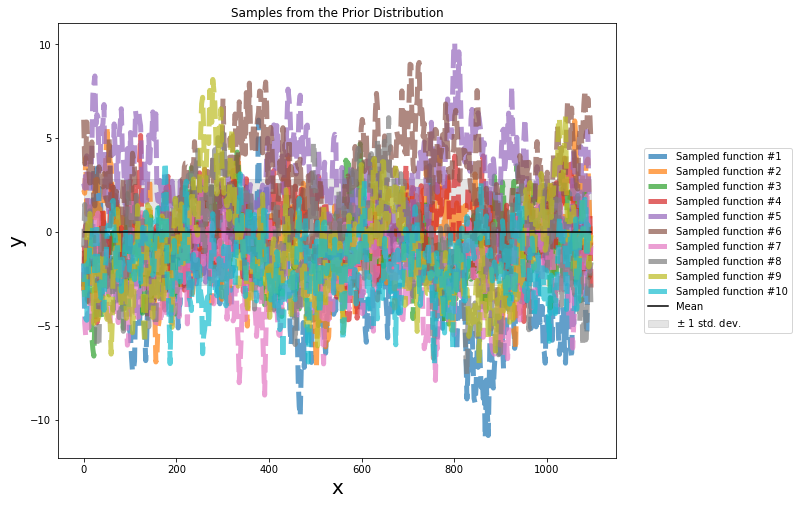

In [94]:
#GENERATING THE GPR MODEL
gpr_temp = GaussianProcessRegressor(kernel = final_kernel , alpha = 0.75**2,n_restarts_optimizer=10)

#PLOTTING THE PRIOR DISTRIBUTION
fig, axs = plt.subplots(nrows=1, sharex=True, sharey=True, figsize=(10, 8))

plot_gpr_samples(gpr_temp, n_samples=10,ax = axs)
axs.set_title("Samples from the Prior Distribution")
axs.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")

## GP fitting

In [97]:
ee = 1/3*len(y_temp) #index to indicate which observations to include
print(ee)

test_train_split(X_temp,y_temp)

1866.0


In [100]:
aa = 1
ee = int(1/8*len(y_temp)) #index to indicate which observations to include
print("Number of Observations to Include: "+ str(ee))

#FITTING THE GAUSSIAN PROCESS
gpr_temp.fit(X_temp[aa:ee],y_temp[aa:ee])

Number of Observations to Include: 699


GaussianProcessRegressor(alpha=0.5625,
                         kernel=1**2 * RBF(length_scale=365) + 2**2 * ExpSineSquared(length_scale=1, periodicity=365) + 1.73**2 * RationalQuadratic(alpha=1, length_scale=2) + 0.05**2 * RBF(length_scale=0.1) + WhiteKernel(noise_level=0.0025),
                         n_restarts_optimizer=10)

Text(0.5, 1.0, 'GP fit to Data: Regressing on Time and SST')

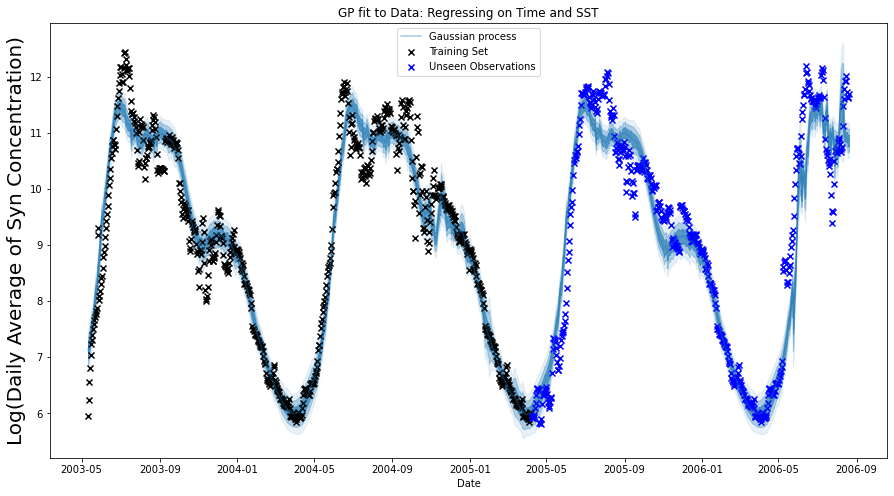

In [107]:
horizon = 500
jj = ee + horizon

X_test_temp = X_temp.copy()
mean_y_pred_temp, std_y_pred_temp = gpr_temp.predict(X_test_temp, return_std=True)
mean_y_pred_temp += y_mean_temp

dfd["mean_y_pred_temp"] = mean_y_pred_temp
dfd["std_y_pred_temp"] = std_y_pred_temp


mean_y_pred_temp = mean_y_pred_temp.reshape(len(y_temp))
std_y_pred_temp =  std_y_pred_temp.reshape(len(y_temp))

y_samples_temp = gpr_temp.sample_y(X_test_temp[1:jj],5)


plt.figure(figsize=(15, 8))

#PLOTTING GP FIT
plt.plot(dfd.date[1:jj], mean_y_pred_temp[1:jj], color="tab:blue", alpha=0.4, label="Gaussian process")

#PLOTTING STD
plt.fill_between(
    dfd.date[1:jj],
    (mean_y_pred_temp- 3*std_y_pred_temp)[1:jj],
    (mean_y_pred_temp + 3*std_y_pred_temp)[1:jj],
    color="tab:blue",
    alpha=0.1,
)

plt.fill_between(
    dfd.date[1:jj],
    (mean_y_pred_temp- 2*std_y_pred_temp)[1:jj],
    (mean_y_pred_temp + 2*std_y_pred_temp)[1:jj],
    color="tab:blue",
    alpha=0.3,
)

plt.fill_between(
    dfd.date[1:jj],
    (mean_y_pred_temp- std_y_pred_temp)[1:jj],
    (mean_y_pred_temp + std_y_pred_temp)[1:jj],
    color="tab:blue",
    alpha=0.6,
)

#PLOTTING OBSERVATIONS put into model
plt.scatter(dfd.date[1:ee], y_temp[1:ee]+y_mean_temp,color="black",marker = "x", label="Training Set")

#PLOTTING OBSERVATIONS beyond model
plt.scatter(dfd.date[ee:jj], y_temp[ee:jj]+y_mean_temp,color="blue",marker = "x", label="Unseen Observations")

plt.legend()
plt.xlabel("Date")
plt.ylabel("Log(Daily Average of Syn Concentration)", fontsize = 20)
plt.title("GP fit to Data: Regressing on Time and SST")
# plot_gpr_samples_2D(gpr_temp, n_samples=5,ax = axs)


#SAMPLING FROM THE POSTERIOR

# for idx, single_prior in enumerate(y_samples_temp.T):
# #     print(single_prior)
#     plt.plot(
#         dfd.date[1:jj],
#         single_prior.transpose() +y_mean_temp,
#         linestyle="--",
#         alpha=0.7,
#         label=f"Sampled function #{idx + 1}",
#     )

# plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")


   month       date              variable      conc
1    5.0 2003-05-12  log_syn_interpolated  6.229464
2    5.0 2003-05-13  log_syn_interpolated  6.557437
3    5.0 2003-05-14  log_syn_interpolated  6.800940
4    5.0 2003-05-15  log_syn_interpolated  7.030663
5    5.0 2003-05-16  log_syn_interpolated  7.227483
   month       date              variable      conc
1    NaN 2005-04-09  log_syn_interpolated  5.916657
2    NaN 2005-04-10  log_syn_interpolated  5.911799
3    NaN 2005-04-11  log_syn_interpolated  5.925599
4    NaN 2005-04-12  log_syn_interpolated  5.976016
5    NaN 2005-04-13  log_syn_interpolated  6.090212


Text(0.5, 1.0, 'Predictive check')

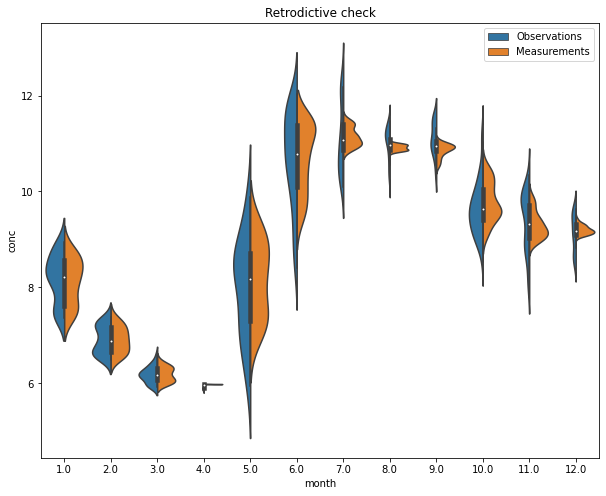

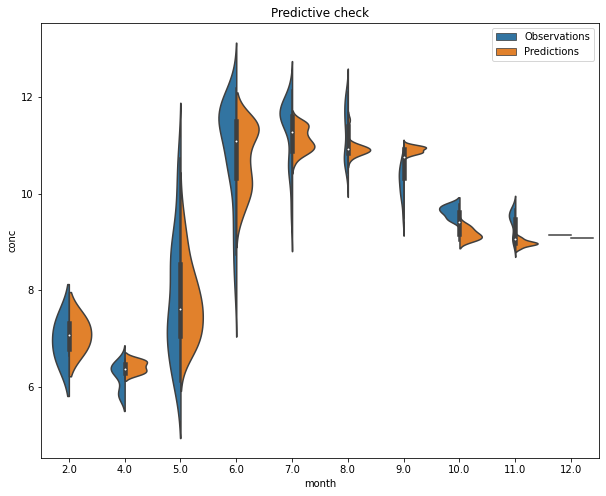

In [193]:
dfd[["date","log_syn_interpolated","mean_y_pred_temp"]][1:ee].head()

dfv = pd.melt(dfd[["month","date","log_syn_interpolated","mean_y_pred_temp"]].loc[1:ee],id_vars =["month","date"],value_vars =["log_syn_interpolated","mean_y_pred_temp"],value_name = "conc")
print(dfv.loc[1:ee].head())

plt.figure(figsize = (10,8))
ax = sns.violinplot(data = dfv ,x = "month" , y = "conc",hue = "variable",split = True, )
ax.legend(handles=ax.legend_.legendHandles, labels=["Observations","Measurements"])
ax.set_title("Retrodictive check")

dfd[["date","log_syn_interpolated","mean_y_pred_temp"]][1:ee].head()

dfv = pd.melt(dfd[["month","date","log_syn_interpolated","mean_y_pred_temp"]].loc[ee:jj],id_vars =["month","date"],value_vars =["log_syn_interpolated","mean_y_pred_temp"],value_name = "conc")
print(dfv.loc[1:ee].head())

plt.figure(figsize = (10,8))
ax = sns.violinplot(data = dfv ,x = "month" , y = "conc",hue = "variable",split = True, )
ax.legend(handles=ax.legend_.legendHandles, labels=["Observations","Predictions"])
ax.set_title("Predictive check")

   month       date              variable      conc
1    5.0 2003-05-11  log_syn_interpolated  5.945203
2    5.0 2003-05-12  log_syn_interpolated  6.229464
3    5.0 2003-05-13  log_syn_interpolated  6.557437
4    5.0 2003-05-14  log_syn_interpolated  6.800940
5    5.0 2003-05-15  log_syn_interpolated  7.030663


<AxesSubplot:xlabel='month', ylabel='conc'>

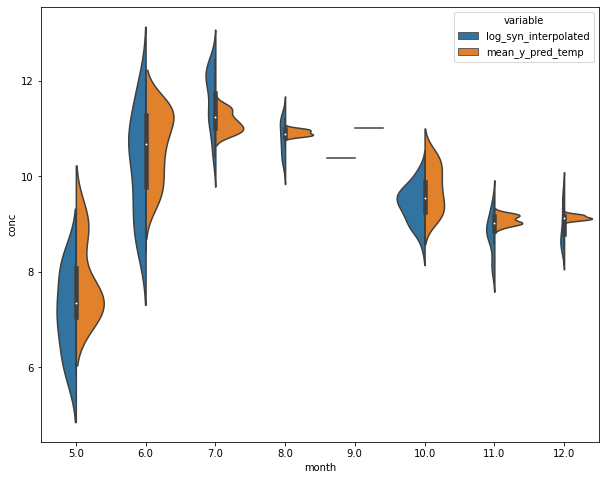

In [173]:
dfd[["date","log_syn_interpolated","mean_y_pred_temp"]][1:ee].head()

dfv = pd.melt(dfd[["month","date","log_syn_interpolated","mean_y_pred_temp"]][dfd.year == 2003],id_vars =["month","date"],value_vars =["log_syn_interpolated","mean_y_pred_temp"],value_name = "conc")
print(dfv.loc[1:ee].head())

plt.figure(figsize = (10,8))
sns.violinplot(data = dfv ,x = "month" , y = "conc",hue = "variable",split = True, )

## Plotting Observations and the Fit to the GP

In [ ]:
plt.figure(figsize=(25, 15))

#PLOTTING OBSERVATIONS
plt.scatter(dfd.date[1:ee], y[1:ee]+ y_mean_temp,color="black",marker = "x", label="Observations")

jj =  2000

#PLOTTING GP FIT
plt.plot(dfd.date[1:jj], mean_y_pred_temp[1:jj], color="tab:blue", alpha=0.4, label="Gaussian process")

#PLOTTING STD
plt.fill_between(
    dfd.date[1:jj],
    (mean_y_pred_temp- std_y_pred_temp)[1:jj],
    (mean_y_pred_temp + std_y_pred_temp)[1:jj],
    color="tab:blue",
    alpha=0.2,
)

plt.legend()
plt.xlabel("Date",fontsize = 20)
plt.ylabel("Log(Daily Average of Syn Concentration)", fontsize = 20)
plt.title("GP fit to Data: Regressing on Time and SST", fontsize = 20)
# plot_gpr_samples_2D(gpr_temp, n_samples=5,ax = axs)


#SAMPLING FROM THE POSTERIOR

for idx, single_prior in enumerate(y_samples_temp.T):
#     print(single_prior)
    plt.plot(
        dfd.date[1:jj],
        single_prior.transpose()[1:jj] +y_mean_temp,
        linestyle="--",
        alpha=0.2,
        label=f"Sampled function #{idx + 1}",
    )

plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")


In [109]:
print("Calibration Score: " + str(cs(y_temp+y_mean_temp,mean_y_pred_temp,std_y_pred_temp)))

Calibration Score: 87.03690442490527


In [126]:
np.sort((y_temp+y_mean_temp))

N = len((y_temp+y_mean_temp))
np.arange(N) / float(N)

array([0.00000000e+00, 1.78635227e-04, 3.57270454e-04, ...,
       9.99464094e-01, 9.99642730e-01, 9.99821365e-01])

In [140]:
dfd.groupby("year")[mean_y_pred]

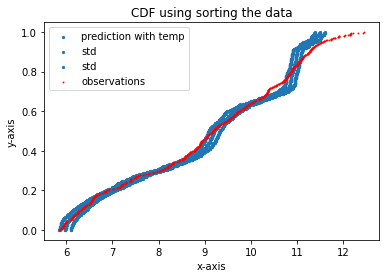

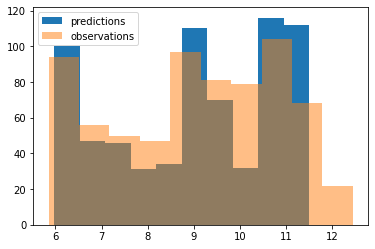

In [196]:
def plot_cdf(data,labelt):
    N = len(data)
    x = np.sort(data)
    # get the cdf values of y
    y = np.arange(N) / float(N)

    # plotting
    plt.xlabel('x-axis')
    plt.ylabel('y-axis')

    plt.title('CDF using sorting the data')

    plt.scatter(x, y, marker='.',s = 20,label = labelt,c = "tab:blue")
    plt.legend()
    
# plot_cdf(mean_y_pred,labelt = "prediction ")
plot_cdf(mean_y_pred_temp[1:ee],labelt = "prediction with temp")
plot_cdf(mean_y_pred_temp[1:ee]-std_y_pred_temp[1:ee],labelt = "std")
plot_cdf(mean_y_pred_temp[1:ee]+std_y_pred_temp[1:ee],labelt = "std")
# plot_cdf(dfd.log_syn_interpolated[1:ee],labelt = "obrvation")

N = len(dfd.log_syn_interpolated[1:ee])
x = np.sort(dfd.log_syn_interpolated[1:ee])
# get the cdf values of y
y = np.arange(N) / float(N)

# plotting
plt.xlabel('x-axis')
plt.ylabel('y-axis')

plt.title('CDF using sorting the data')

plt.scatter(x, y, marker='.',label = "observations",s =3,c = "r")
plt.legend()


plt.figure()
plt.hist(mean_y_pred_temp[1:ee],label = "predictions")
plt.hist(dfd.log_syn_interpolated[1:ee],label = "observations",alpha = 0.5)
plt.legend()

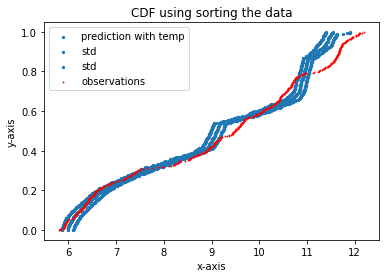

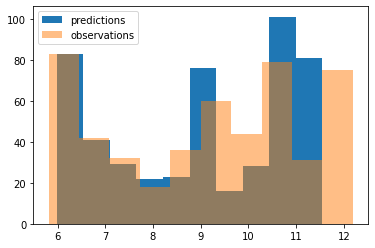

In [197]:
# plot_cdf(mean_y_pred,labelt = "prediction ")
plot_cdf(mean_y_pred_temp[ee:jj],labelt = "prediction with temp")
plot_cdf(mean_y_pred_temp[ee:jj]-std_y_pred_temp[ee:jj],labelt = "std")
plot_cdf(mean_y_pred_temp[ee:jj]+std_y_pred_temp[ee:jj],labelt = "std")
# plot_cdf(dfd.log_syn_interpolated[1:jj],labelt = "obrvation")

N = len(dfd.log_syn_interpolated[ee:jj])
x = np.sort(dfd.log_syn_interpolated[ee:jj])
# get the cdf values of y
y = np.arange(N) / float(N)

# plotting
plt.xlabel('x-axis')
plt.ylabel('y-axis')

plt.title('CDF using sorting the data')

plt.scatter(x, y, marker='.',label = "observations",s =3,c = "r")
plt.legend()


plt.figure()
plt.hist(mean_y_pred_temp[ee:jj],label = "predictions")
plt.hist(dfd.log_syn_interpolated[ee:jj],label = "observations",alpha = 0.5)
plt.legend()

# INVESTIGATE FREQUENCY OF OBSERVATIONS